# Projekt 2
### Biblioteki 

In [1]:
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.cluster import KMeans, AgglomerativeClustering,DBSCAN, MiniBatchKMeans
from scipy.cluster import hierarchy
from sklearn.preprocessing import normalize, scale
import numpy as np
from sklearn.manifold import TSNE
from sklearn.metrics import silhouette_score
import seaborn as sns
from sklearn.preprocessing import OneHotEncoder
from tqdm import tqdm

## Dane

In [2]:
df=pd.read_csv('online_shoppers_intention.csv')

In [3]:
df.Weekend=df.Weekend.astype(int)
df.Revenue=df.Revenue.astype(int)
df["VisitorType"]=df["VisitorType"].transform(lambda x: 1 if x=="Returning_Visitor" else (0 if x=="New_Visitor" else -1))
month_dict={'Jan': 1,
 'Feb': 2,
 'Mar': 3,
 'Apr': 4,
 'May': 5,
 'June': 6,
 'Jul': 7,
 'Aug': 8,
 'Sep': 9,
 'Oct': 10,
 'Nov': 11,
 'Dec': 12}
df["Month"]=df["Month"].map(month_dict)
data=df
df

,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,Month,OperatingSystems,Browser,Region,TrafficType,VisitorType,Weekend,Revenue
0,0,0.0,0,0.0,1,0.000000,0.200000,0.200000,0.000000,0.0,2,1,1,1,1,1,0,0
1,0,0.0,0,0.0,2,64.000000,0.000000,0.100000,0.000000,0.0,2,2,2,1,2,1,0,0
2,0,0.0,0,0.0,1,0.000000,0.200000,0.200000,0.000000,0.0,2,4,1,9,3,1,0,0
3,0,0.0,0,0.0,2,2.666667,0.050000,0.140000,0.000000,0.0,2,3,2,2,4,1,0,0
4,0,0.0,0,0.0,10,627.500000,0.020000,0.050000,0.000000,0.0,2,3,3,1,4,1,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12325,3,145.0,0,0.0,53,1783.791667,0.007143,0.029031,12.241717,0.0,12,4,6,1,1,1,1,0
12326,0,0.0,0,0.0,5,465.750000,0.000000,0.021333,0.000000,0.0,11,3,2,1,8,1,1,0
12327,0,0.0,0,0.0,6,184.250000,0.083333,0.086667,0.000000,0.0,11,3,2,1,13,1,1,0
12328,4,75.0,0,0.0,15,346.000000,0.000000,0.021053,0.000000,0.0,11,2,2,3,11,1,0,0


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12330 entries, 0 to 12329
Data columns (total 18 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Administrative           12330 non-null  int64  
 1   Administrative_Duration  12330 non-null  float64
 2   Informational            12330 non-null  int64  
 3   Informational_Duration   12330 non-null  float64
 4   ProductRelated           12330 non-null  int64  
 5   ProductRelated_Duration  12330 non-null  float64
 6   BounceRates              12330 non-null  float64
 7   ExitRates                12330 non-null  float64
 8   PageValues               12330 non-null  float64
 9   SpecialDay               12330 non-null  float64
 10  Month                    12330 non-null  int64  
 11  OperatingSystems         12330 non-null  int64  
 12  Browser                  12330 non-null  int64  
 13  Region                   12330 non-null  int64  
 14  TrafficType           

In [5]:
month=df['Month']

In [6]:
categorical=df[['VisitorType','Revenue','Weekend','SpecialDay','Browser','Region','OperatingSystems','TrafficType','Informational']]
df=df.drop(['Month','VisitorType','Revenue','Weekend','SpecialDay','Browser','Region','OperatingSystems','TrafficType','Informational'],axis='columns')

## Skalowanie danych 

In [7]:
scaled_df=scale(df)
scaled_df=pd.DataFrame(scaled_df)
scaled_df.columns=df.columns
scaled_df

,Administrative,Administrative_Duration,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues
0,-0.696993,-0.457191,-0.244931,-0.691003,-0.624348,3.667189,3.229316,-0.317178
1,-0.696993,-0.457191,-0.244931,-0.668518,-0.590903,-0.457683,1.171473,-0.317178
2,-0.696993,-0.457191,-0.244931,-0.691003,-0.624348,3.667189,3.229316,-0.317178
3,-0.696993,-0.457191,-0.244931,-0.668518,-0.622954,0.573535,1.994610,-0.317178
4,-0.696993,-0.457191,-0.244931,-0.488636,-0.296430,-0.045196,0.142551,-0.317178
...,...,...,...,...,...,...,...,...
12325,0.206173,0.363075,-0.244931,0.478227,0.307822,-0.310366,-0.288966,0.342125
12326,-0.696993,-0.457191,-0.244931,-0.601062,-0.380957,-0.457683,-0.447364,-0.317178
12327,-0.696993,-0.457191,-0.244931,-0.578577,-0.528063,1.261014,0.897093,-0.317178
12328,0.507228,-0.032916,-0.244931,-0.376210,-0.443536,-0.457683,-0.453140,-0.317178


## Normalizowanie danych 

In [8]:
normalized_df=normalize(df)
normalized_df=pd.DataFrame(normalized_df)
normalized_df.columns=df.columns
normalized_df

,Administrative,Administrative_Duration,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues
0,0.000000,0.000000,0.0,0.962250,0.000000,0.192450,0.192450,0.000000
1,0.000000,0.000000,0.0,0.031235,0.999511,0.000000,0.001562,0.000000
2,0.000000,0.000000,0.0,0.962250,0.000000,0.192450,0.192450,0.000000
3,0.000000,0.000000,0.0,0.599404,0.799206,0.014985,0.041958,0.000000
4,0.000000,0.000000,0.0,0.015934,0.999873,0.000032,0.000080,0.000000
...,...,...,...,...,...,...,...,...
12325,0.001676,0.080983,0.0,0.029601,0.996251,0.000004,0.000016,0.006837
12326,0.000000,0.000000,0.0,0.010735,0.999942,0.000000,0.000046,0.000000
12327,0.000000,0.000000,0.0,0.032547,0.999470,0.000452,0.000470,0.000000
12328,0.011287,0.211640,0.0,0.042328,0.976365,0.000000,0.000059,0.000000


## Kodowanie kategoryczne 

In [9]:
month_cos = np.cos(2 * np.pi * month/max(month))
month_sin = np.sin(2 * np.pi * month/max(month))
months=pd.DataFrame(data={'month_cos':month_cos,'month_sin':month_sin})
months

,month_cos,month_sin
0,0.500000,8.660254e-01
1,0.500000,8.660254e-01
2,0.500000,8.660254e-01
3,0.500000,8.660254e-01
4,0.500000,8.660254e-01
...,...,...
12325,1.000000,-2.449294e-16
12326,0.866025,-5.000000e-01
12327,0.866025,-5.000000e-01
12328,0.866025,-5.000000e-01


In [10]:
enc=OneHotEncoder()
enc.fit(categorical)
encoded=pd.DataFrame(enc.transform(categorical).toarray())
encoded

,0,1,2,3,4,5,6,7,8,9,...,70,71,72,73,74,75,76,77,78,79
0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12325,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
12326,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
12327,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
12328,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [11]:
df=pd.concat([df,encoded], axis=1)
scaled_df=pd.concat([scaled_df,encoded], axis=1)
normalized_df=pd.concat([normalized_df,encoded], axis=1)

df=pd.concat([df,months], axis=1)
scaled_df=pd.concat([scaled_df,months], axis=1)
normalized_df=pd.concat([normalized_df,months], axis=1)

In [12]:
df

,Administrative,Administrative_Duration,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,0,1,...,72,73,74,75,76,77,78,79,month_cos,month_sin
0,0,0.0,0.0,1,0.000000,0.200000,0.200000,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.500000,8.660254e-01
1,0,0.0,0.0,2,64.000000,0.000000,0.100000,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.500000,8.660254e-01
2,0,0.0,0.0,1,0.000000,0.200000,0.200000,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.500000,8.660254e-01
3,0,0.0,0.0,2,2.666667,0.050000,0.140000,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.500000,8.660254e-01
4,0,0.0,0.0,10,627.500000,0.020000,0.050000,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.500000,8.660254e-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12325,3,145.0,0.0,53,1783.791667,0.007143,0.029031,12.241717,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.000000,-2.449294e-16
12326,0,0.0,0.0,5,465.750000,0.000000,0.021333,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.866025,-5.000000e-01
12327,0,0.0,0.0,6,184.250000,0.083333,0.086667,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.866025,-5.000000e-01
12328,4,75.0,0.0,15,346.000000,0.000000,0.021053,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.866025,-5.000000e-01


### Metoda łokcia

In [13]:
# Code copied from laboratory file
from scipy.spatial import distance
def count_clustering_scores(X, cluster_num, model_class, score_fun):
    if isinstance(cluster_num, int):
        cluster_num_iter = [cluster_num]
    else:
        cluster_num_iter = cluster_num
    scores = []    
    for k in cluster_num_iter:
        model_instance = model_class(n_clusters=k)
        labels = model_instance.fit_predict(X)
        wcss = score_fun(X, labels)
        scores.append(wcss)
    
    if isinstance(cluster_num, int):
        return scores[0]
    else:
        return scores
def count_clustering_scores_agl(X, cluster_num, model_class, score_fun):
    if isinstance(cluster_num, int):
        cluster_num_iter = [cluster_num]
    else:
        cluster_num_iter = cluster_num
    scores = []    
    for k in cluster_num_iter:
        model_instance = model_class(n_clusters=k,linkage="ward")
        labels = model_instance.fit_predict(X)
        wcss = score_fun(X, labels)
        scores.append(wcss)
    
    if isinstance(cluster_num, int):
        return scores[0]
    else:
        return scores
def mean_dist_to_center(X, label):
    clusters = set(label)
    inclust_dist_list = []
    for cluster_i in clusters:
        cluster_i_idx = np.where(label == cluster_i)
        cluster_i_mean = np.mean(X[cluster_i_idx], axis=0, keepdims=True)
        inclust_dist = np.mean(distance.cdist(X[cluster_i_idx], cluster_i_mean))
        inclust_dist_list.append(inclust_dist)
    return np.mean(inclust_dist_list)

Za pomocą metody łokcia ciężko jest określić optymalną ilość klastrów może to być 2, 4, 6 lub 8. Dlatego spróbujemy metoda silhouette.

### Metoda silhouette

In [14]:
def plots(df):
    vec2=[]
    for cluster_amount in range(4,14):
        model=KMeans(n_clusters=cluster_amount)
        model.fit_predict(df)
        vec2.append(model.inertia_)
    plt.plot(range(4,14),vec2)
    plt.title("Elbow method")
    plt.show()
    vec1=(count_clustering_scores(np.array(df), range(4,15), KMeans, silhouette_score))
    plt.plot(range(4,15),vec1)
    plt.title("Silhouette")
    plt.show()

## Towrzenie Tsne dla poszczególnych zbiorów danych 

In [14]:
tsne=TSNE(n_components=2,n_iter_without_progress=50)
tsne_1=tsne.fit_transform(df)

In [15]:
tsne_1=pd.DataFrame(tsne_1)

<AxesSubplot:xlabel='0', ylabel='1'>

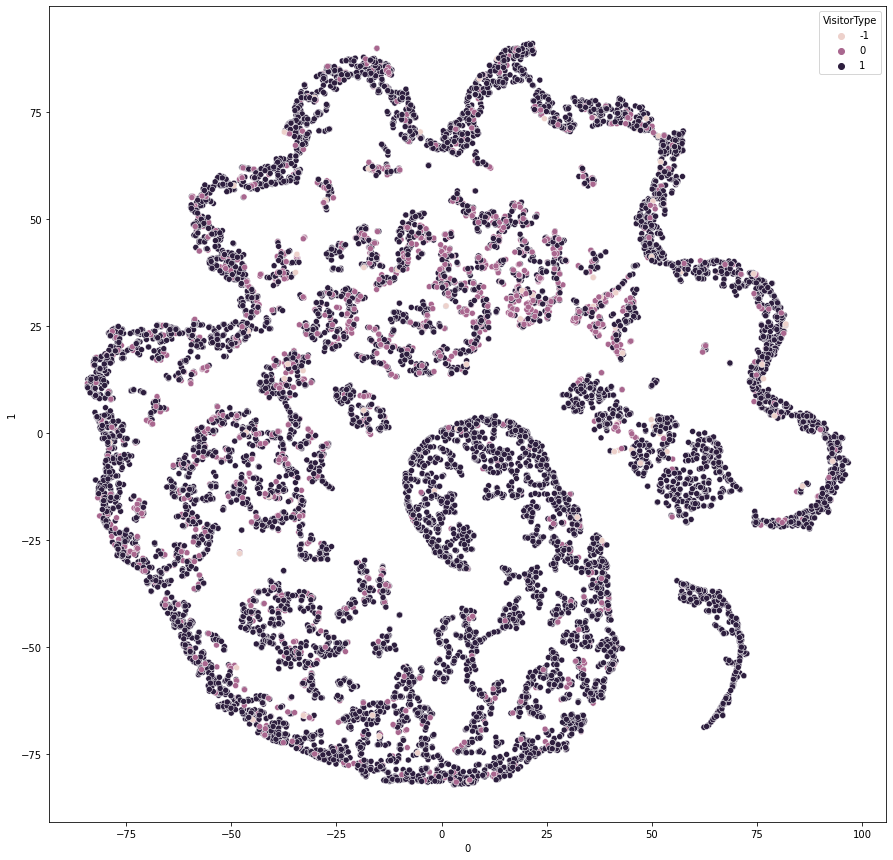

In [16]:
plt.figure(figsize=(15,15))
sns.scatterplot(x=tsne_1[0],y=tsne_1[1],hue=categorical['VisitorType'])

<AxesSubplot:xlabel='0', ylabel='1'>

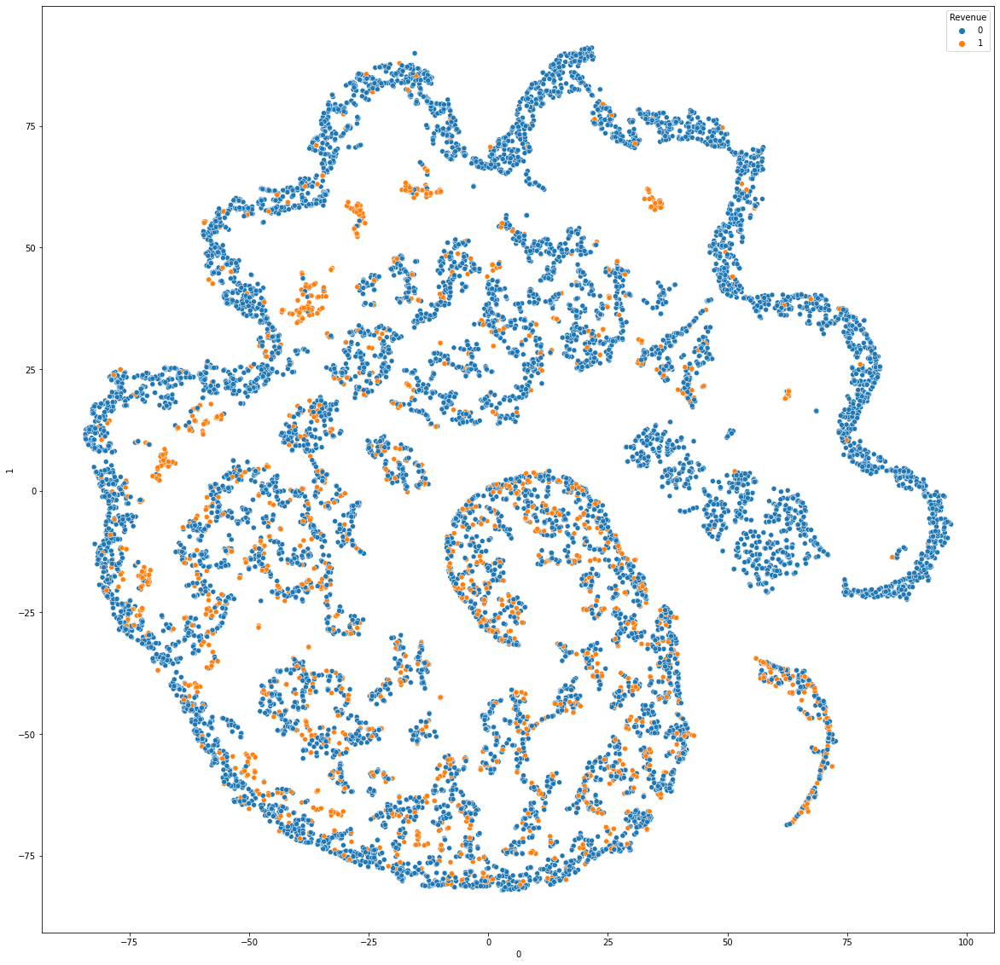

In [17]:
plt.figure(figsize=(20,20))
sns.scatterplot(x=tsne_1[0],y=tsne_1[1],hue=categorical['Revenue'])

In [26]:

tsne_2=tsne.fit_transform(normalized_df)
tsne_2=pd.DataFrame(tsne_2)

<AxesSubplot:xlabel='0', ylabel='1'>

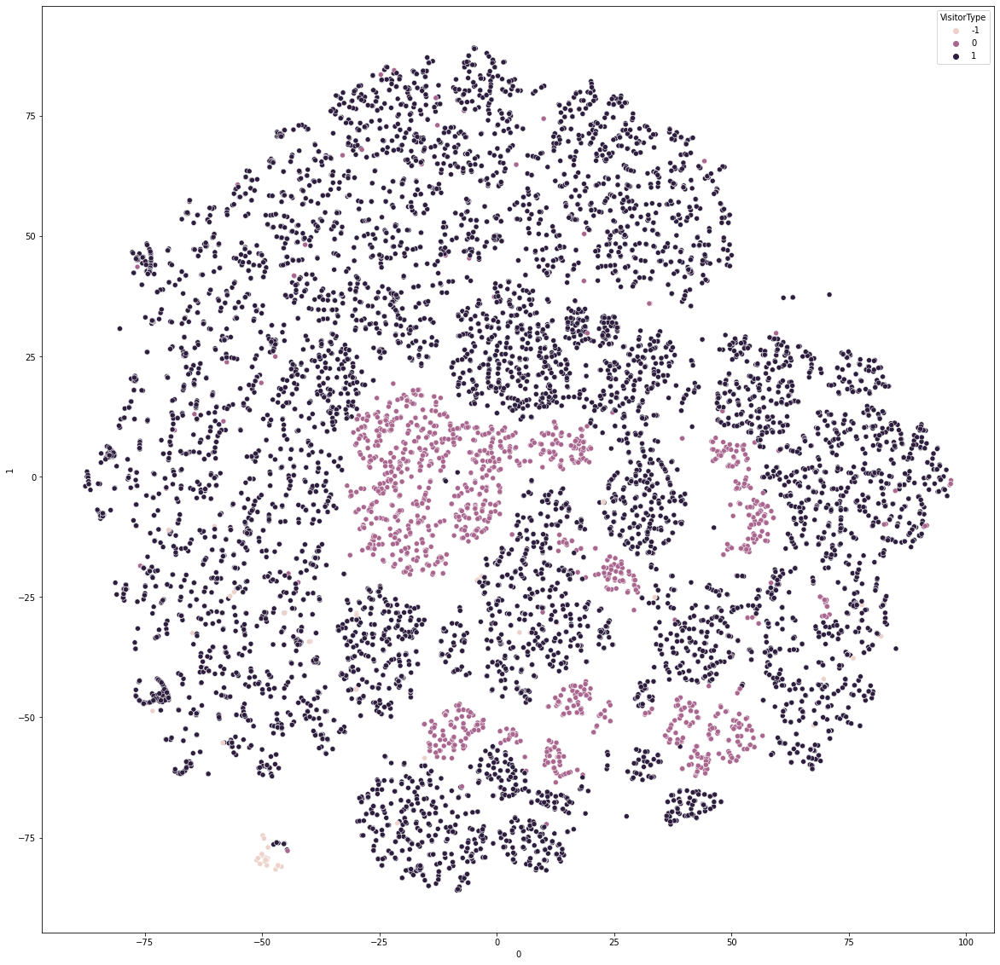

In [27]:
plt.figure(figsize=(20,20))
sns.scatterplot(x=tsne_2[0],y=tsne_2[1],hue=categorical['VisitorType'])

<AxesSubplot:xlabel='0', ylabel='1'>

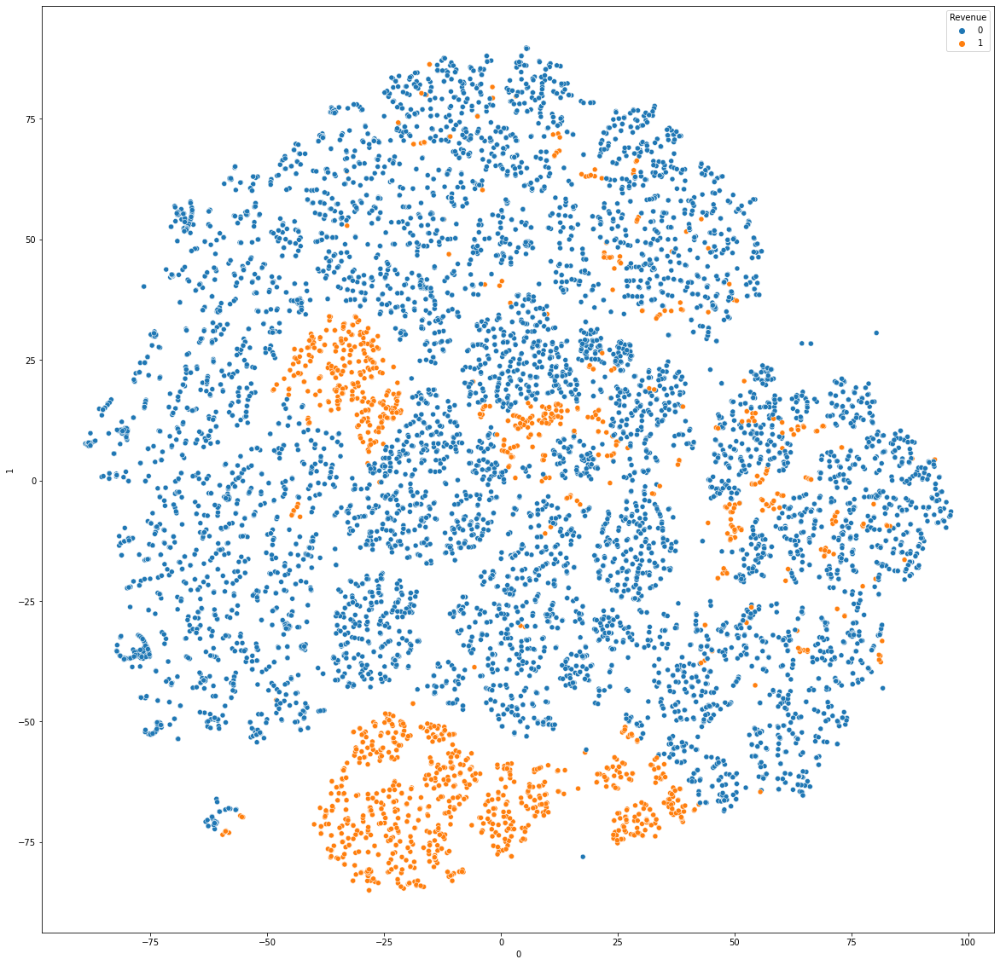

In [21]:
plt.figure(figsize=(20,20))
sns.scatterplot(x=tsne_2[0],y=tsne_2[1],hue=categorical['Revenue'])

<AxesSubplot:xlabel='0', ylabel='1'>

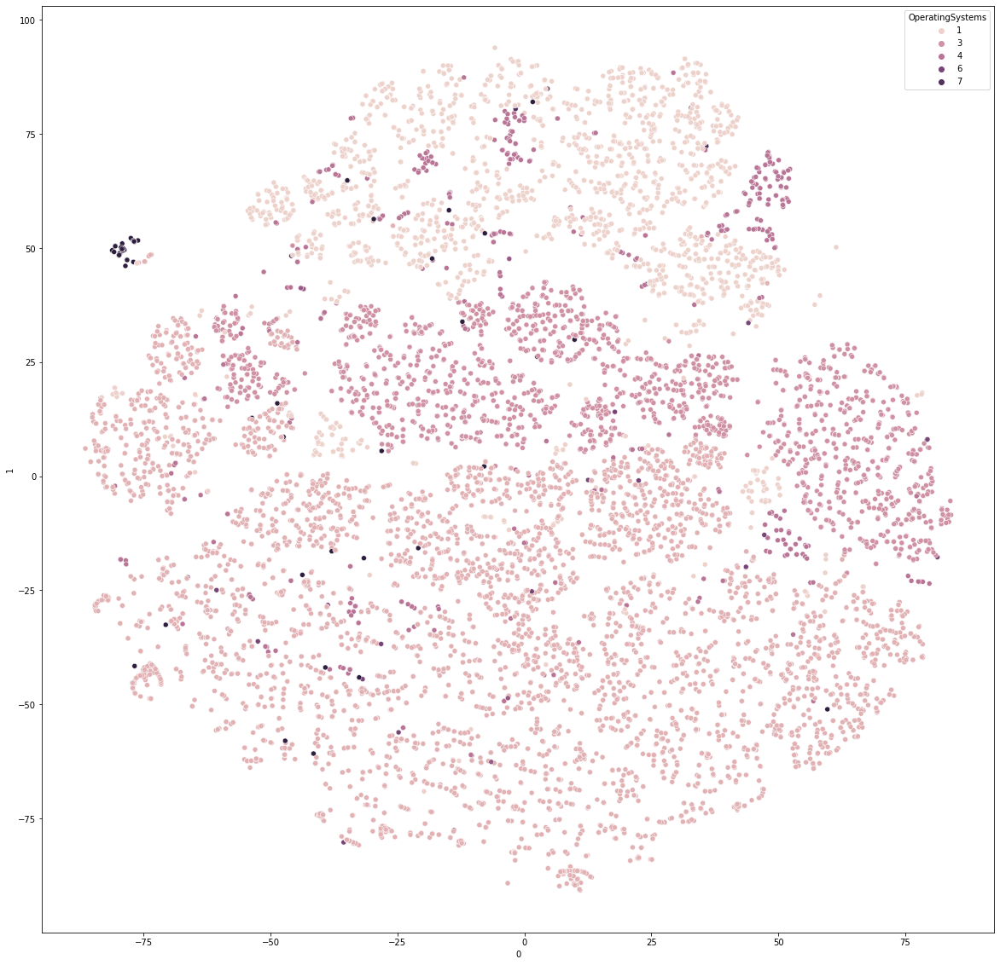

In [25]:
plt.figure(figsize=(20,20))
sns.scatterplot(x=tsne_2[0],y=tsne_2[1],hue=categorical['OperatingSystems'])

In [28]:
tsne_3=tsne.fit_transform(scaled_df)
tsne_3=pd.DataFrame(tsne_3)

<AxesSubplot:xlabel='0', ylabel='1'>

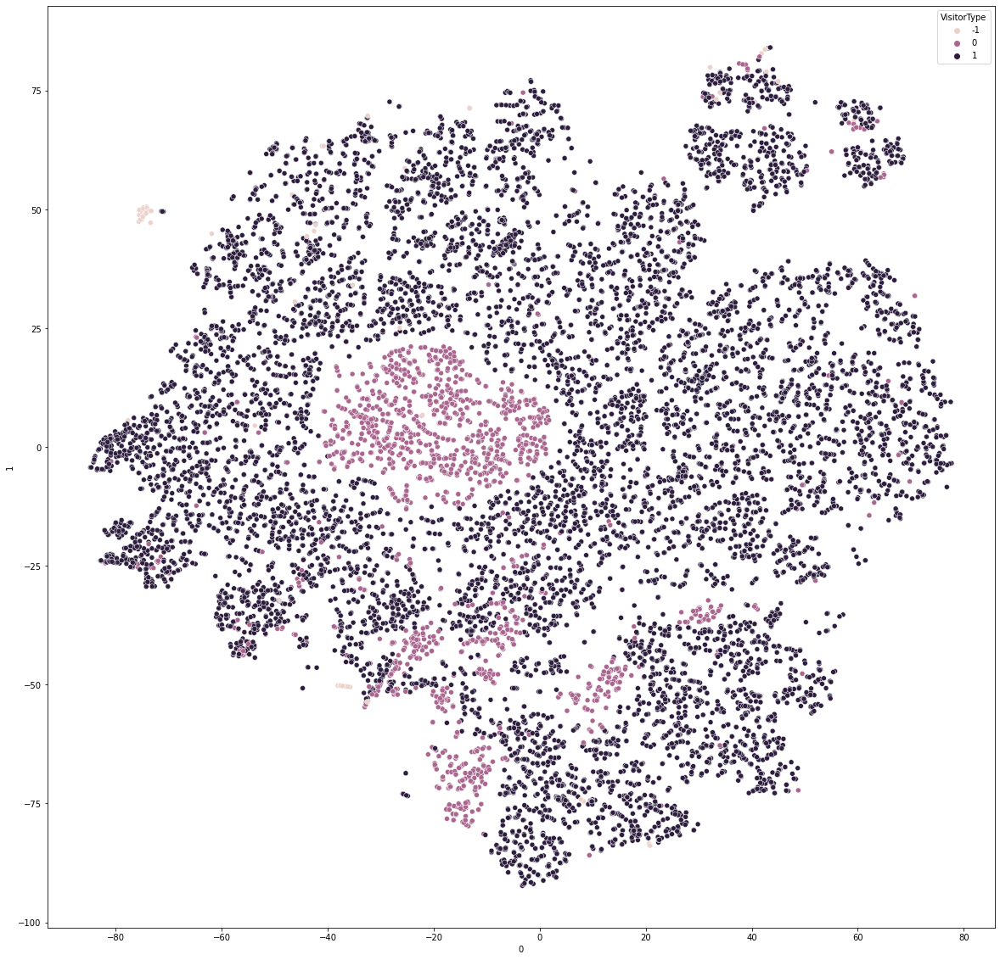

In [29]:
plt.figure(figsize=(20,20))
sns.scatterplot(x=tsne_3[0],y=tsne_3[1],hue=categorical['VisitorType'])

<AxesSubplot:xlabel='0', ylabel='1'>

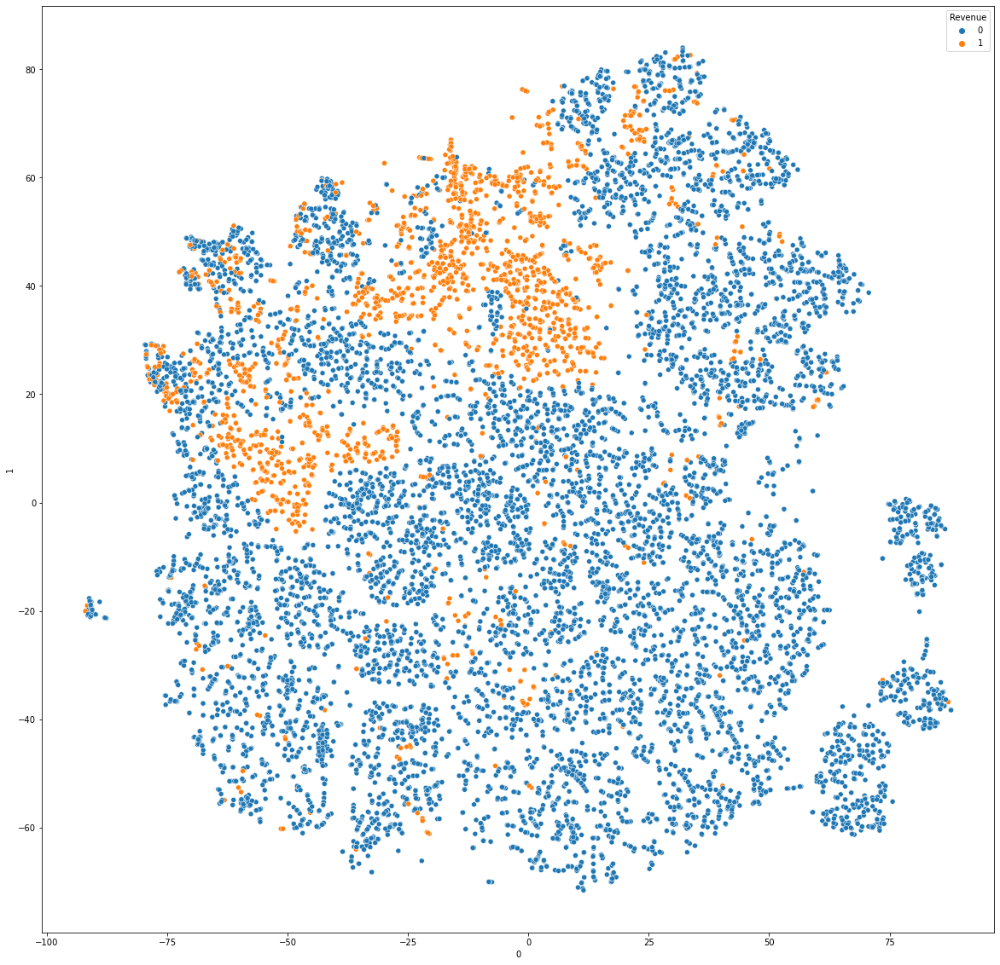

In [22]:
plt.figure(figsize=(20,20))
sns.scatterplot(x=tsne_3[0],y=tsne_3[1],hue=categorical['Revenue'])

<AxesSubplot:xlabel='0', ylabel='1'>

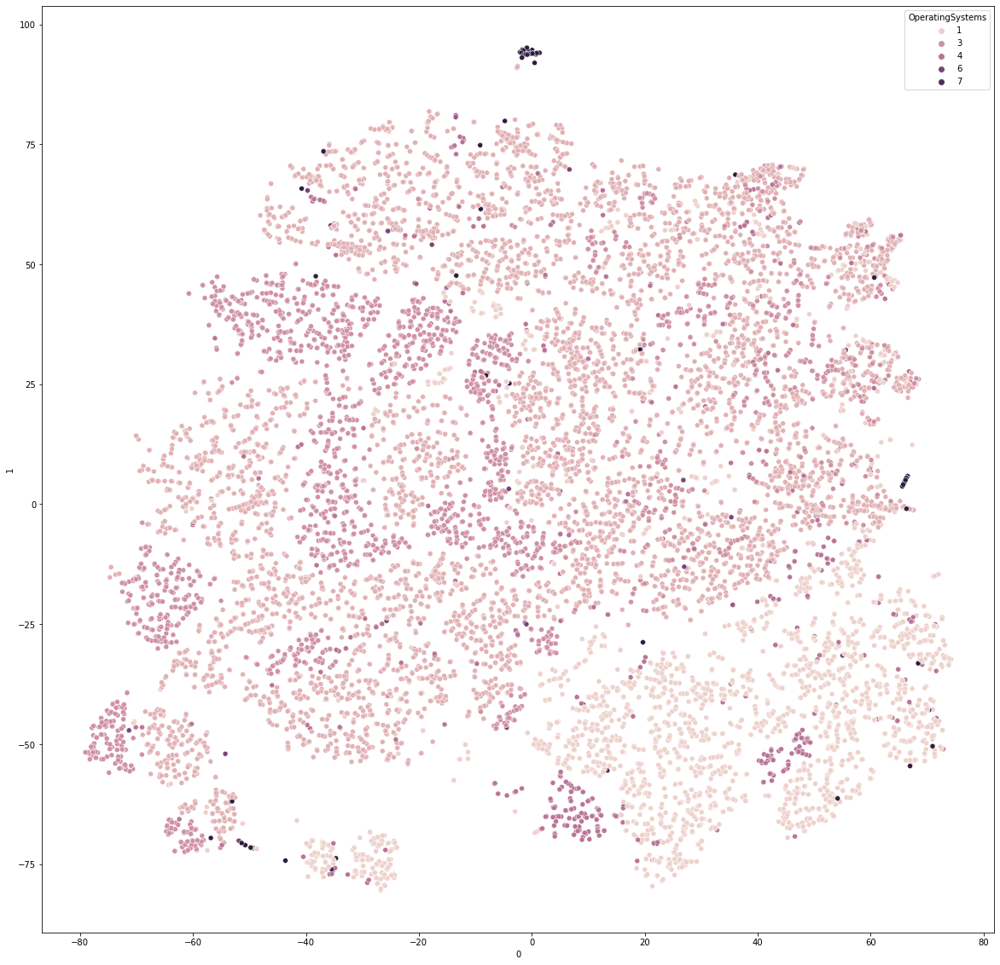

In [29]:
plt.figure(figsize=(20,20))
sns.scatterplot(x=tsne_3[0],y=tsne_3[1],hue=categorical['OperatingSystems'])

<AxesSubplot:xlabel='0', ylabel='1'>

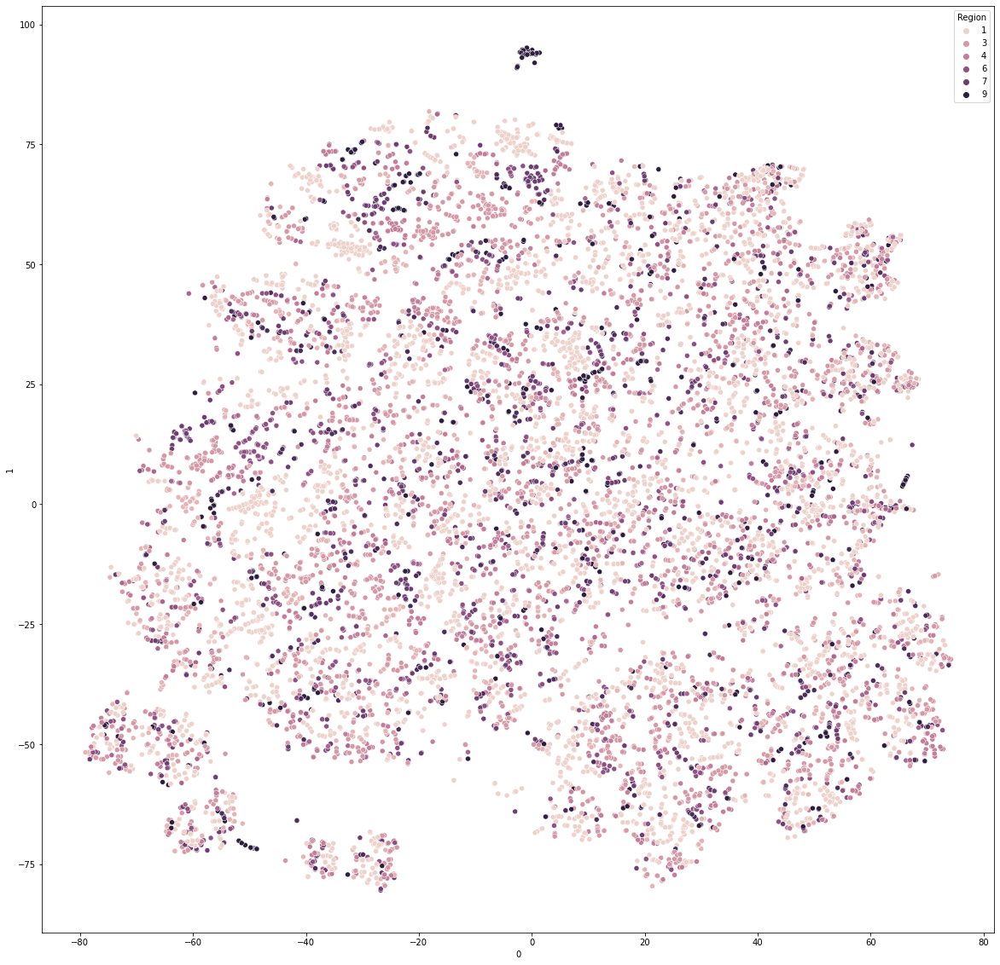

In [30]:
plt.figure(figsize=(20,20))
sns.scatterplot(x=tsne_3[0],y=tsne_3[1],hue=categorical['Region'])

## Klastrowanie 
### Dla skalowanego zbioru

<AxesSubplot:xlabel='0', ylabel='1'>

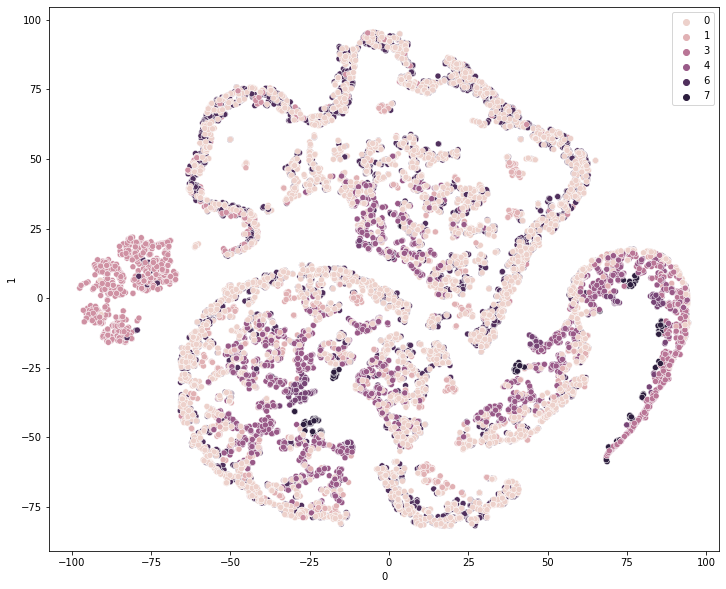

In [50]:
kmeans = KMeans(n_clusters=8)
kmeans.fit(scaled_df)
plt.figure(figsize=(12,10))
sns.scatterplot(x=tsne_4[0],y=tsne_4[1],hue=kmeans.labels_)

<AxesSubplot:xlabel='0', ylabel='1'>

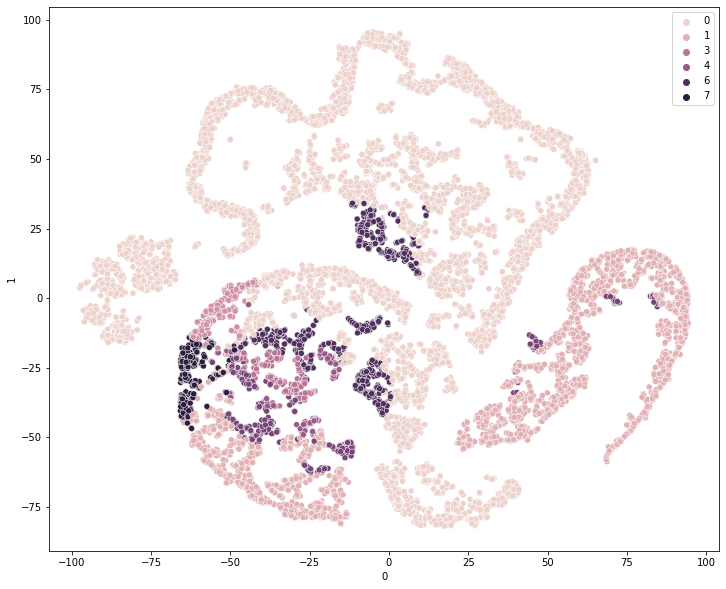

In [49]:
kmeans = KMeans(n_clusters=8)
kmeans.fit(normalize(df2))
plt.figure(figsize=(12,10))
sns.scatterplot(x=tsne_4[0],y=tsne_4[1],hue=kmeans.labels_)

## Eksperyment z DBSCAN

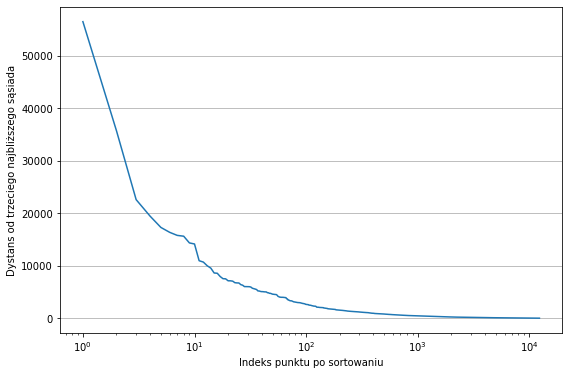

In [25]:
from sklearn.neighbors import NearestNeighbors
minPts = 180
nbrs =NearestNeighbors(n_neighbors=minPts).fit(df)
distances, indices = nbrs.kneighbors(df)
distanceDec = sorted(distances[:,minPts-1], reverse=True)
fig = plt.figure(figsize=(9,6))
ax1 = fig.add_subplot(111)

plt.xlabel('Indeks punktu po sortowaniu')
plt.ylabel('Dystans od trzeciego najbliższego sąsiada')
ax1.plot(list(range(1,df.shape[0]+1)), distanceDec)

plt.xscale('log')
plt.grid(axis='y')

plt.show()

<AxesSubplot:xlabel='0', ylabel='1'>

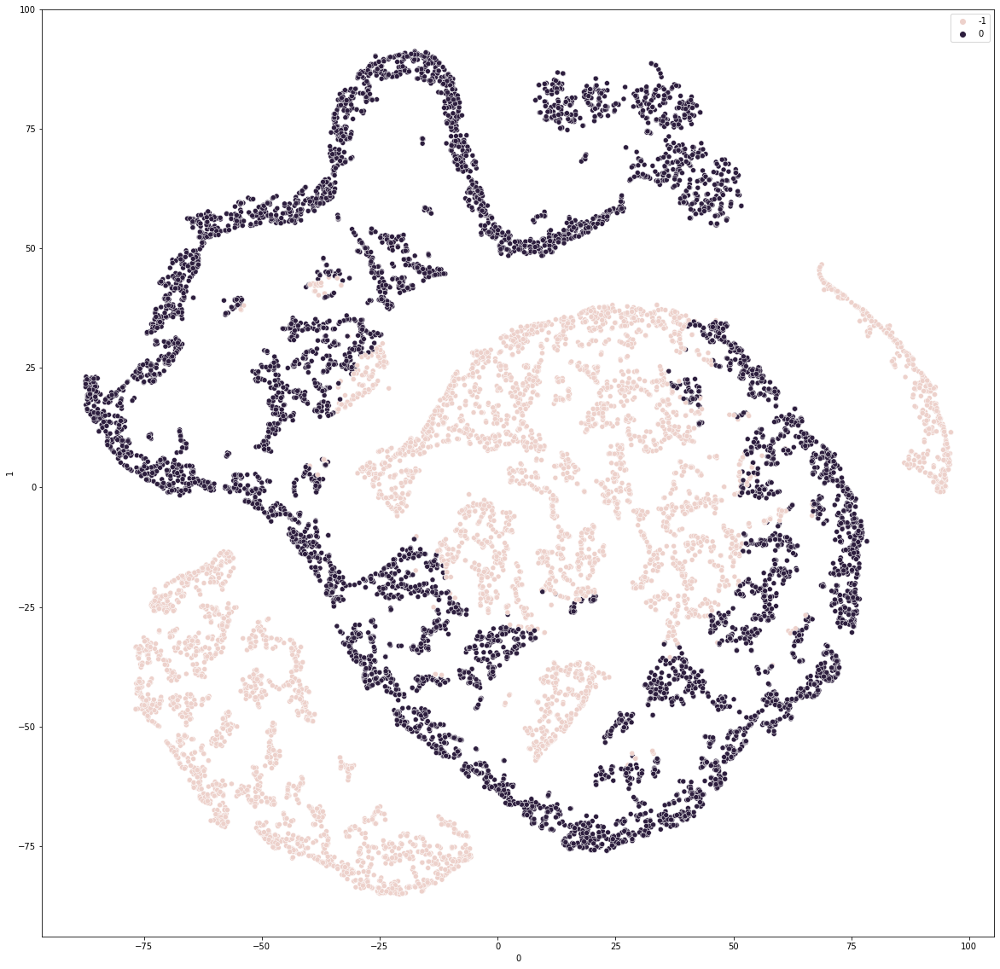

In [26]:
dbscan = DBSCAN( eps=60,min_samples=180)
dbscan.fit(df)
plt.figure(figsize=(20,20))
sns.scatterplot(x=tsne_1[0],y=tsne_1[1],hue=dbscan.labels_)

## Wybory klastrowania za pomocą metody shillueta 

In [18]:
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np

print(__doc__)
def draw_silueat_and_klusters(X, tsne, n):
    # Generating the sample data from make_blobs
    # This particular setting has one distinct cluster and 3 clusters placed close
    # together.

    range_n_clusters = range(2,n)

    for n_clusters in range_n_clusters:
        # Create a subplot with 1 row and 2 columns
        fig, (ax1, ax2) = plt.subplots(1, 2)
        fig.set_size_inches(18, 7)

        # The 1st subplot is the silhouette plot
        # The silhouette coefficient can range from -1, 1 but in this example all
        # lie within [-0.1, 1]
        ax1.set_xlim([-0.1, 1])
        # The (n_clusters+1)*10 is for inserting blank space between silhouette
        # plots of individual clusters, to demarcate them clearly.
        ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

        # Initialize the clusterer with n_clusters value and a random generator
        # seed of 10 for reproducibility.
        clusterer = KMeans(n_clusters=n_clusters, random_state=10)
        cluster_labels = clusterer.fit_predict(X)

        # The silhouette_score gives the average value for all the samples.
        # This gives a perspective into the density and separation of the formed
        # clusters
        silhouette_avg = silhouette_score(X, cluster_labels)
        print("For n_clusters =", n_clusters,
              "The average silhouette_score is :", silhouette_avg)

        # Compute the silhouette scores for each sample
        sample_silhouette_values = silhouette_samples(X, cluster_labels)

        y_lower = 10
        for i in range(n_clusters):
            # Aggregate the silhouette scores for samples belonging to
            # cluster i, and sort them
            ith_cluster_silhouette_values = \
                sample_silhouette_values[cluster_labels == i]

            ith_cluster_silhouette_values.sort()

            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i

            color = cm.nipy_spectral(float(i) / n_clusters)
            ax1.fill_betweenx(np.arange(y_lower, y_upper),
                              0, ith_cluster_silhouette_values,
                              facecolor=color, edgecolor=color, alpha=0.7)

            # Label the silhouette plots with their cluster numbers at the middle
            ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

            # Compute the new y_lower for next plot
            y_lower = y_upper + 10  # 10 for the 0 samples

        ax1.set_title("The silhouette plot for the various clusters.")
        ax1.set_xlabel("The silhouette coefficient values")
        ax1.set_ylabel("Cluster label")

        # The vertical line for average silhouette score of all the values
        ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

        ax1.set_yticks([])  # Clear the yaxis labels / ticks
        ax1.set_xticks([-0.4,-0.3,-0.2,-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

        # 2nd Plot showing the actual clusters formed
        colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
        ax2.scatter(x=tsne[0],y=tsne[1], marker='.', s=30, lw=0, alpha=0.7,
                    c=colors, edgecolor='k')

        ax2.set_title("The visualization of the clustered data.")
        ax2.set_xlabel("Feature space for the 1st feature")
        ax2.set_ylabel("Feature space for the 2nd feature")

        plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                      "with n_clusters = %d" % n_clusters),
                     fontsize=14, fontweight='bold')

    plt.show()

Automatically created module for IPython interactive environment


For n_clusters = 2 The average silhouette_score is : 0.12953580576289508
For n_clusters = 3 The average silhouette_score is : 0.12913740426229145
For n_clusters = 4 The average silhouette_score is : 0.10975630293930527
For n_clusters = 5 The average silhouette_score is : 0.11431588999336281
For n_clusters = 6 The average silhouette_score is : 0.11351865631563683
For n_clusters = 7 The average silhouette_score is : 0.10765658459856363
For n_clusters = 8 The average silhouette_score is : 0.0970528767273383
For n_clusters = 9 The average silhouette_score is : 0.09449065747172973
For n_clusters = 10 The average silhouette_score is : 0.09237322944145866
For n_clusters = 11 The average silhouette_score is : 0.10479562104001308
For n_clusters = 12 The average silhouette_score is : 0.09078083787695508
For n_clusters = 13 The average silhouette_score is : 0.07855415656453023
For n_clusters = 14 The average silhouette_score is : 0.0789685852395979


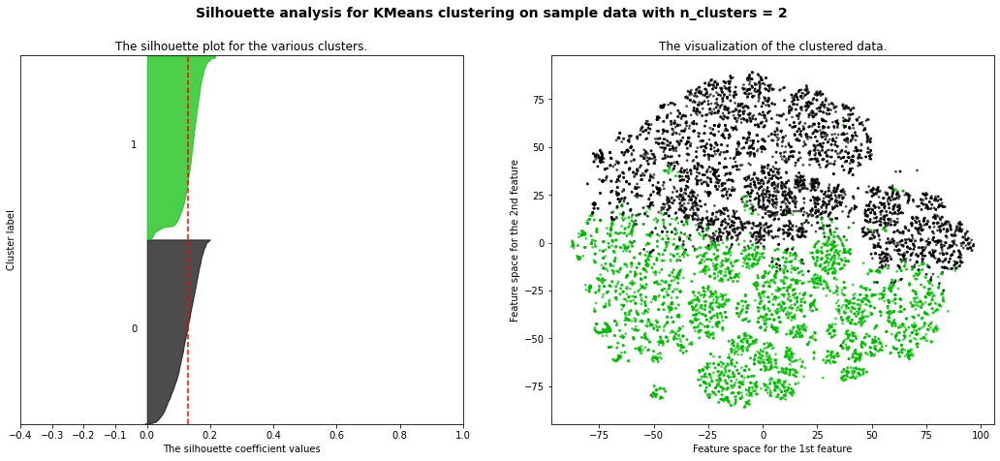

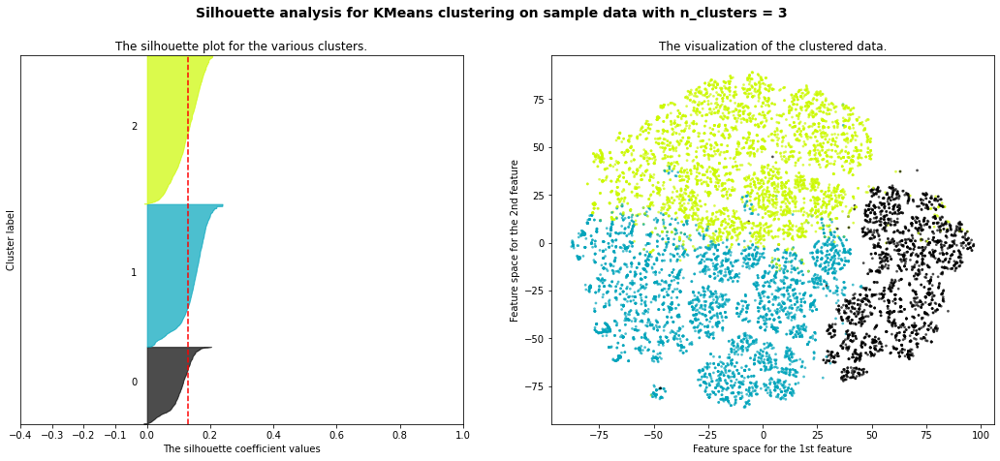

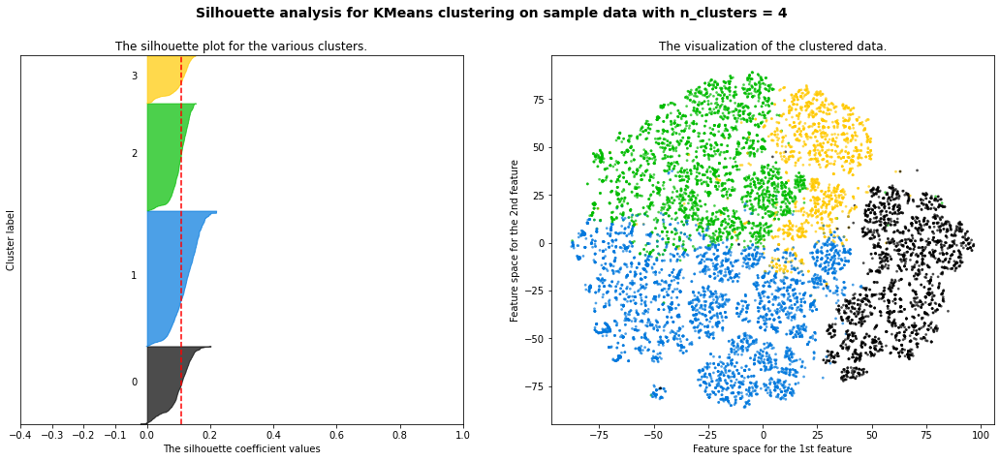

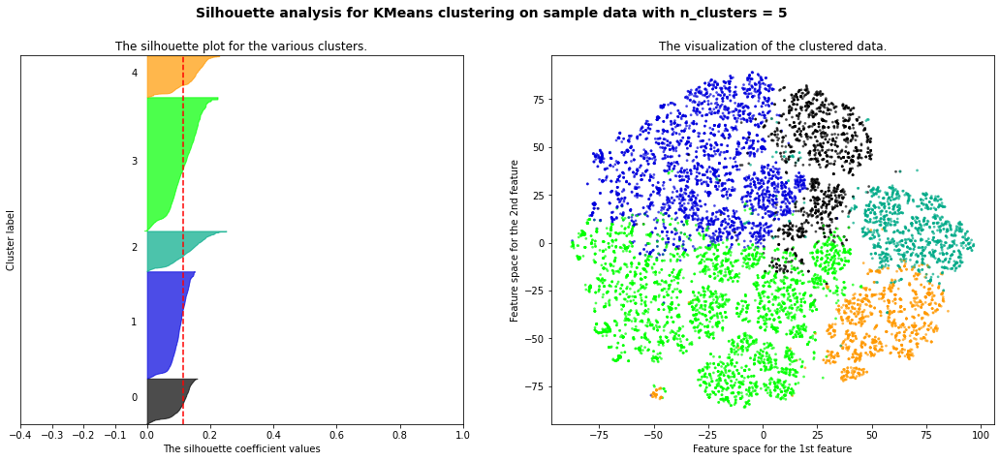

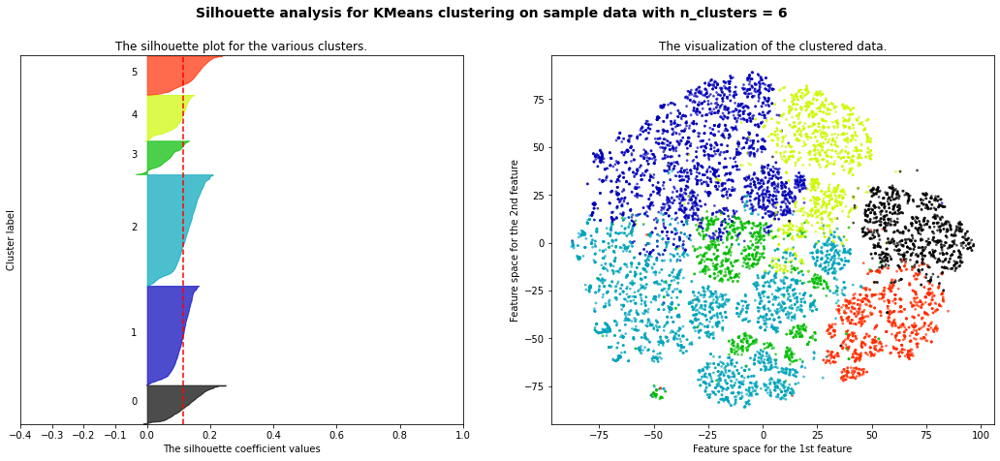

...

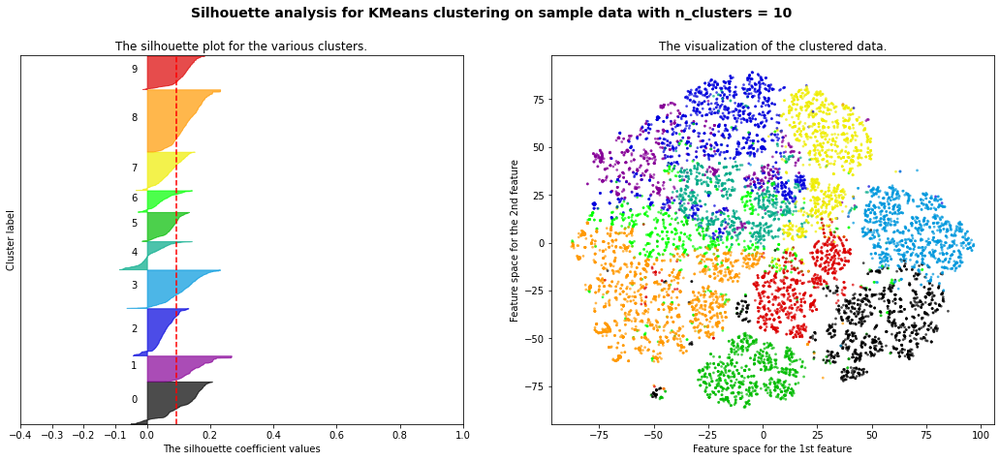

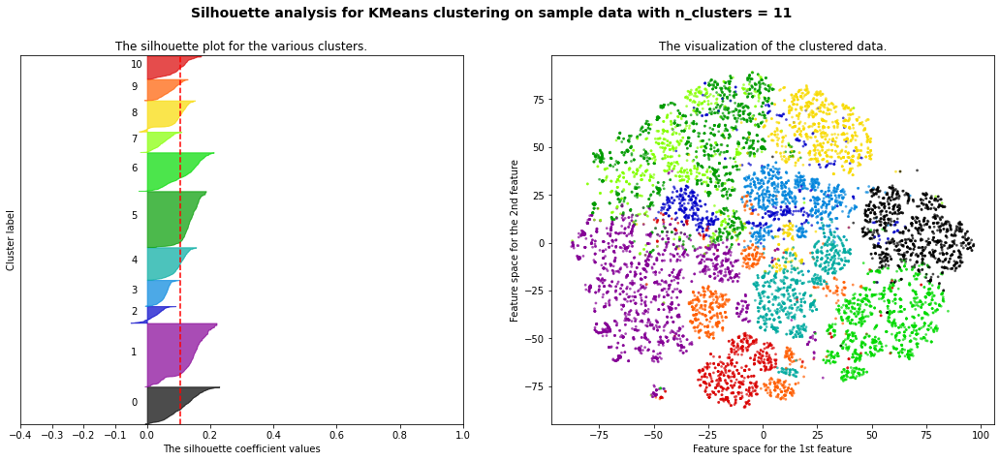

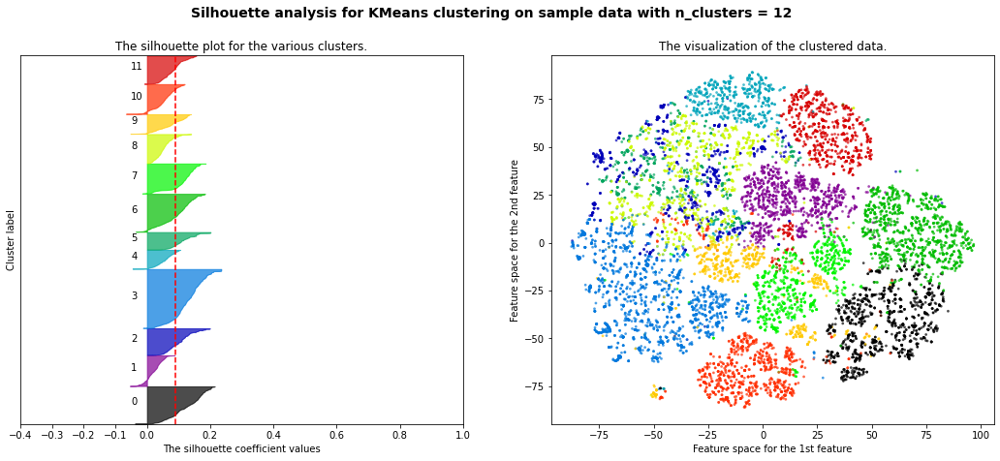

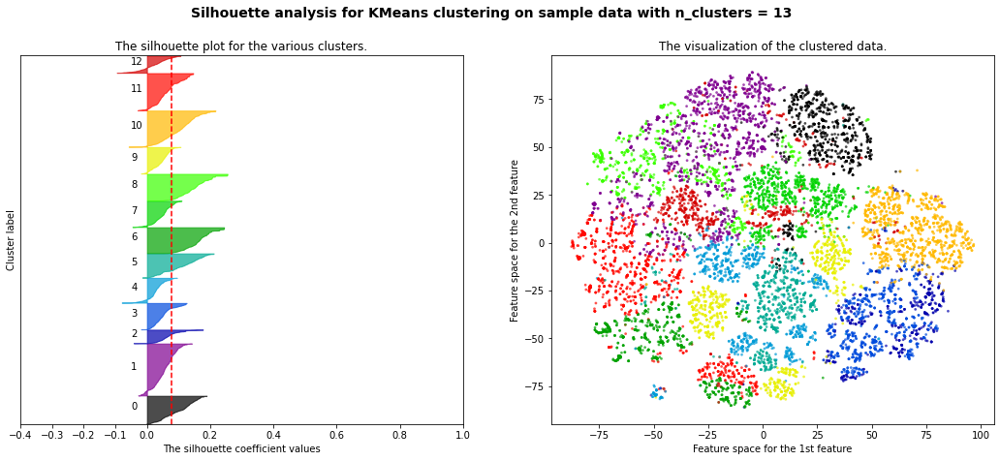

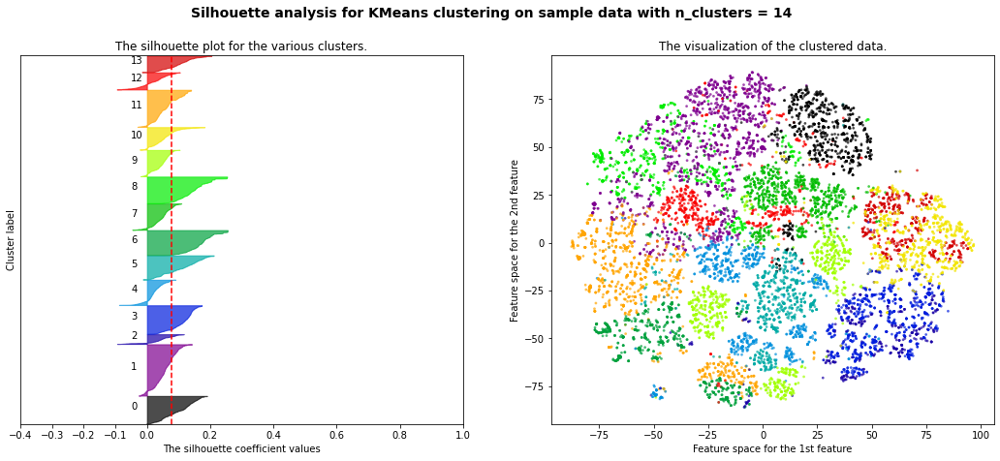

In [30]:
draw_silueat_and_klusters(normalized_df, tsne_2, 15)

### Dla skalowanych

For n_clusters = 2 The average silhouette_score is : 0.2784695939263417
For n_clusters = 3 The average silhouette_score is : 0.27763680047764766
For n_clusters = 4 The average silhouette_score is : 0.19307919323813796
For n_clusters = 5 The average silhouette_score is : 0.19923480907280738
For n_clusters = 6 The average silhouette_score is : 0.11402172693449573
For n_clusters = 7 The average silhouette_score is : 0.12114625115054642
For n_clusters = 8 The average silhouette_score is : 0.12271694963263344


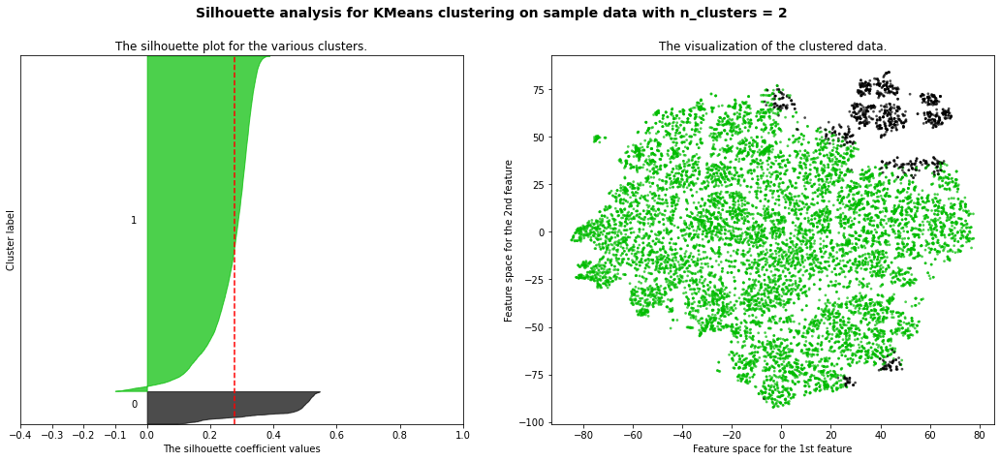

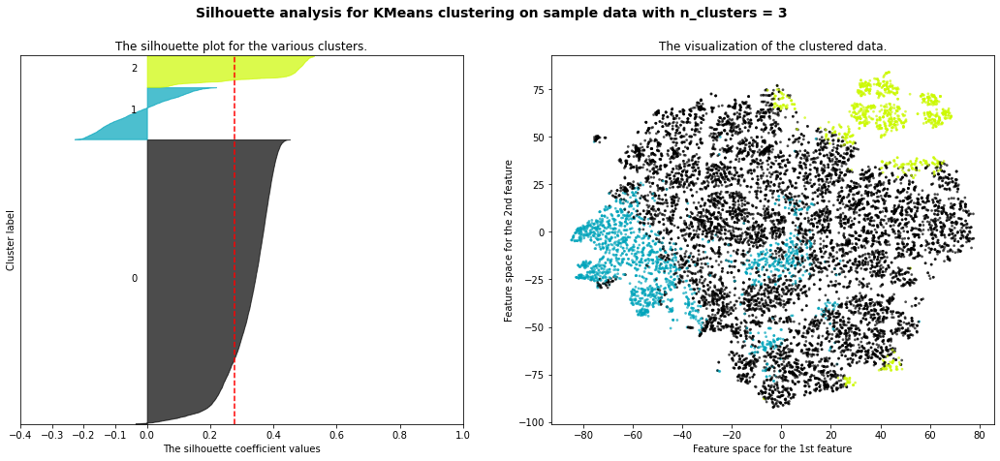

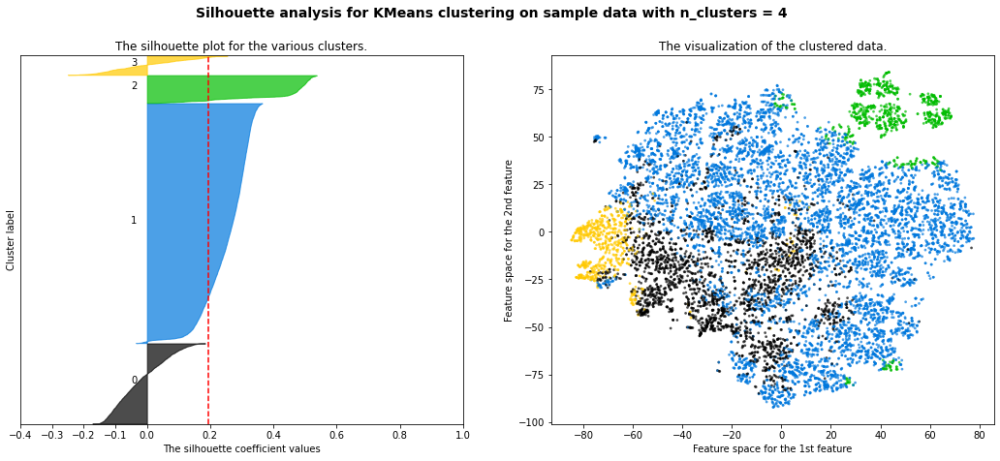

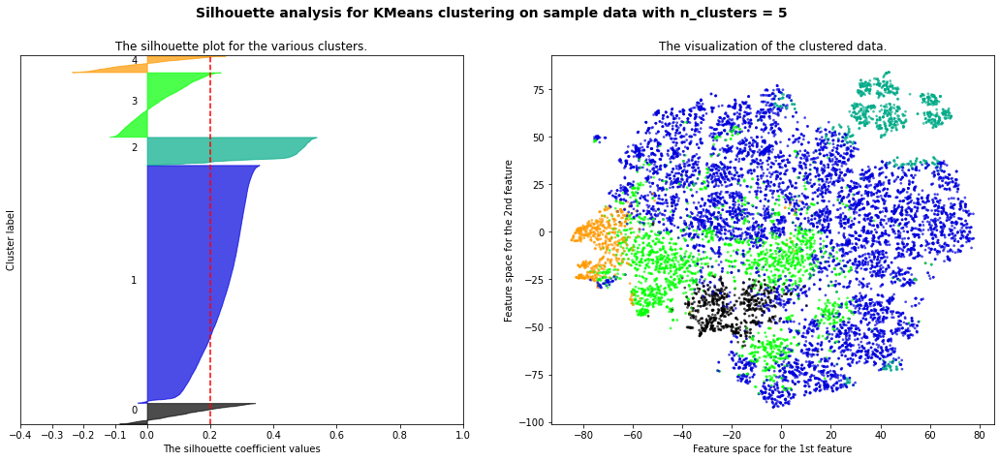

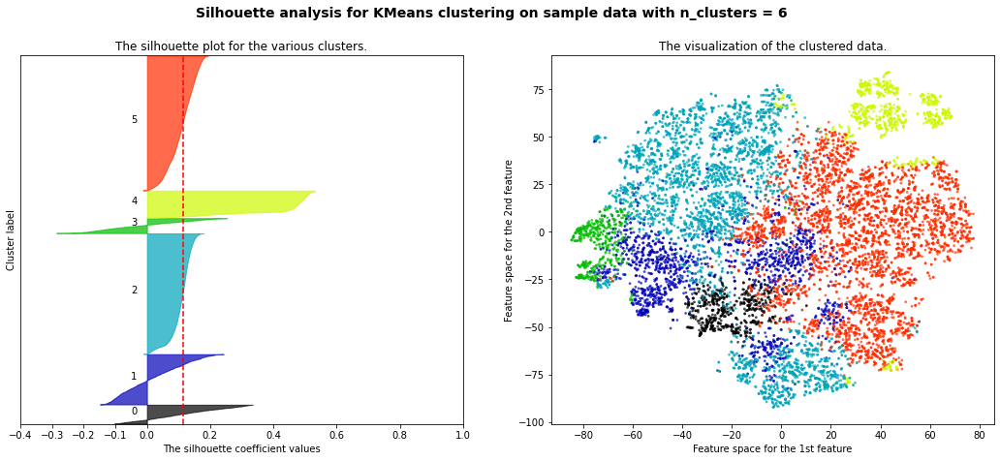

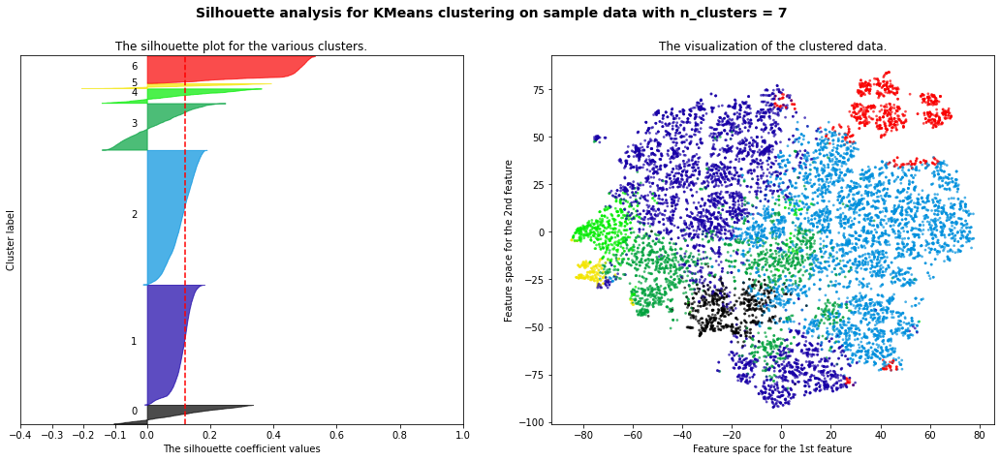

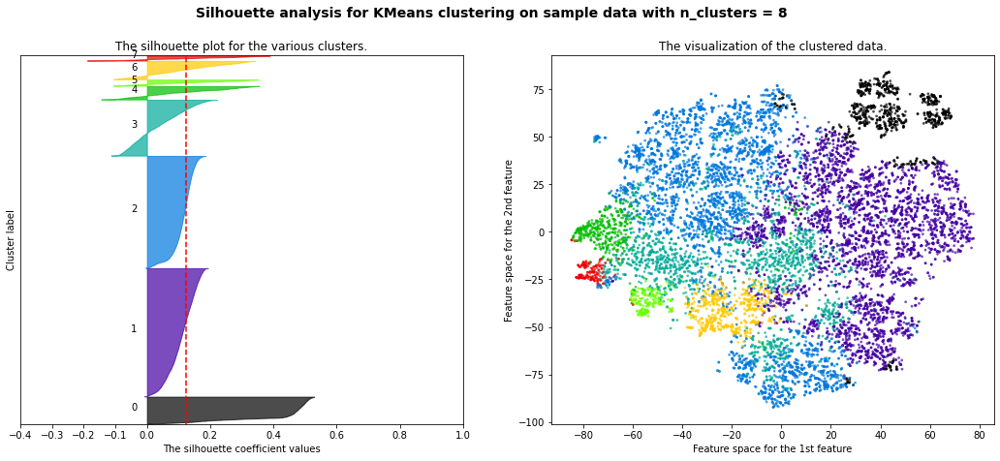

In [31]:
draw_silueat_and_klusters(scaled_df, tsne_3, 9)

In [ ]:
plt.figure(figsize=(20,20))
sns.scatterplot(x=tsne_1[0],y=tsne_1[1],hue=dbscan.)

### Dla zwykłych 

For n_clusters = 2 The average silhouette_score is : 0.781478875741575
For n_clusters = 3 The average silhouette_score is : 0.695000996010159
For n_clusters = 4 The average silhouette_score is : 0.6757878856621885
For n_clusters = 5 The average silhouette_score is : 0.622273724958173
For n_clusters = 6 The average silhouette_score is : 0.6055949633959448
For n_clusters = 7 The average silhouette_score is : 0.5905796228299974
For n_clusters = 8 The average silhouette_score is : 0.5656165014184029
For n_clusters = 9 The average silhouette_score is : 0.5442076193870714


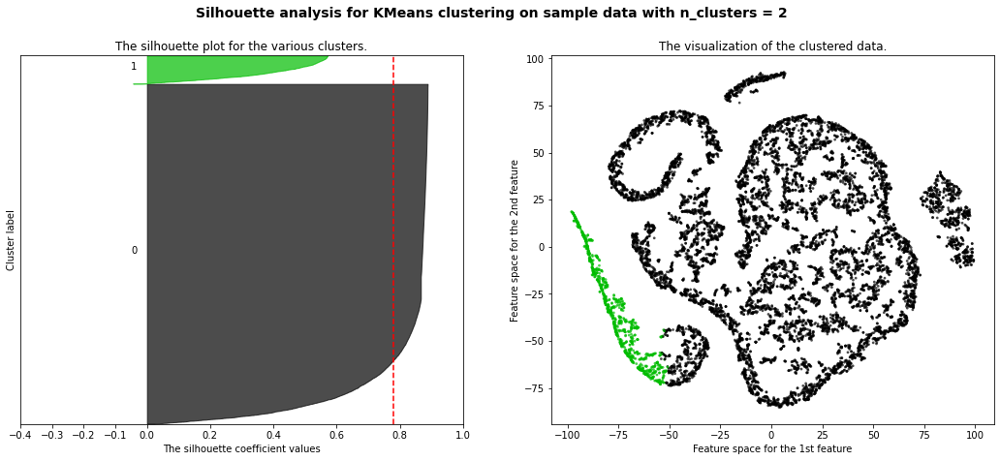

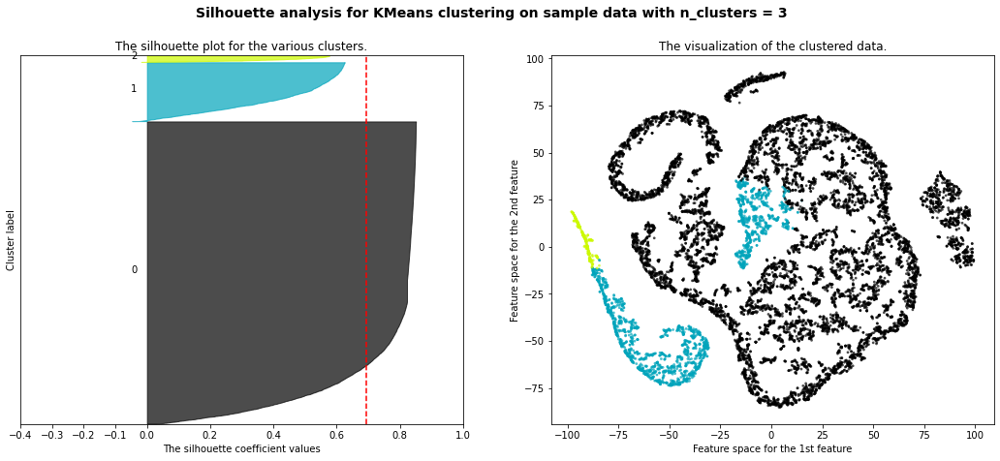

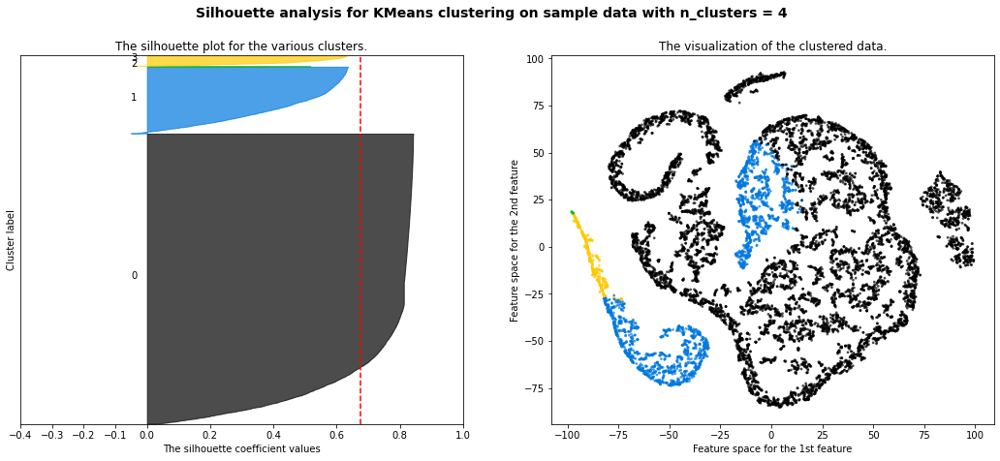

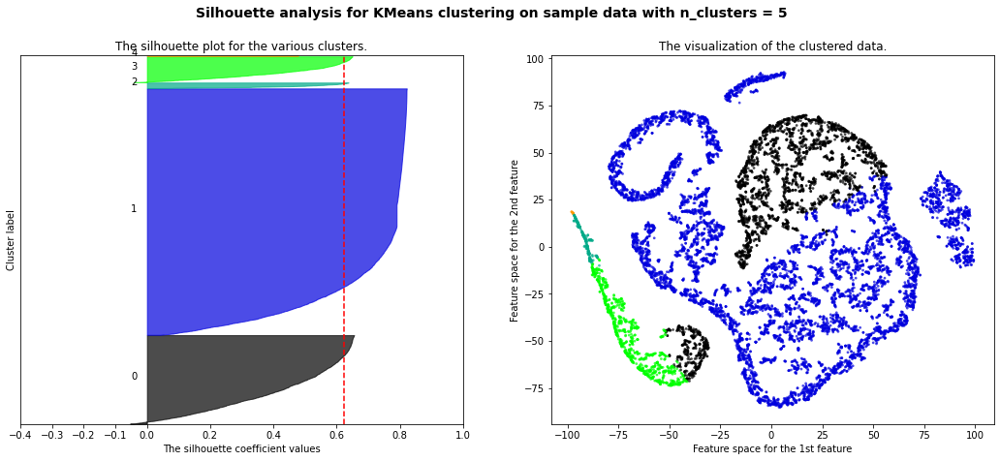

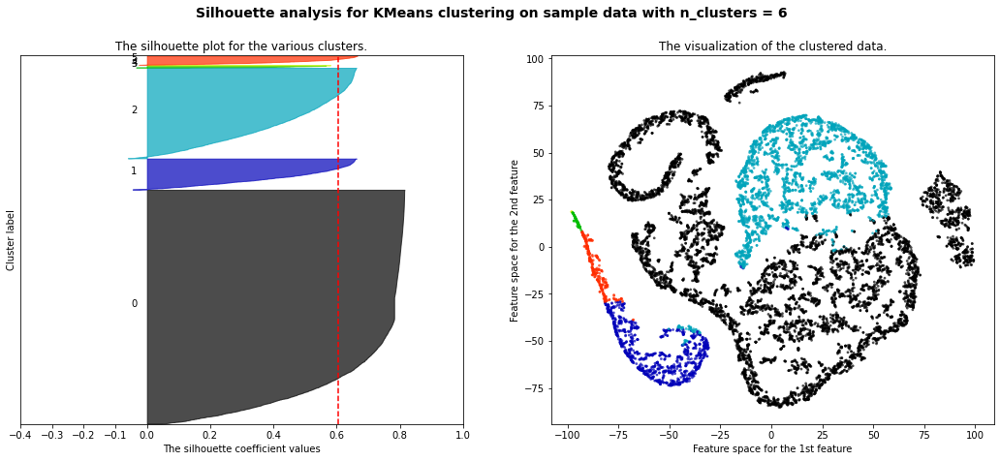

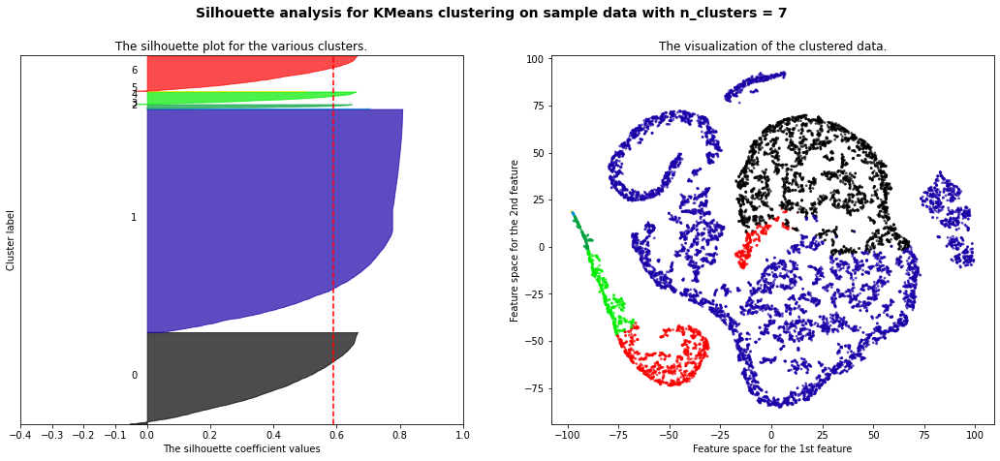

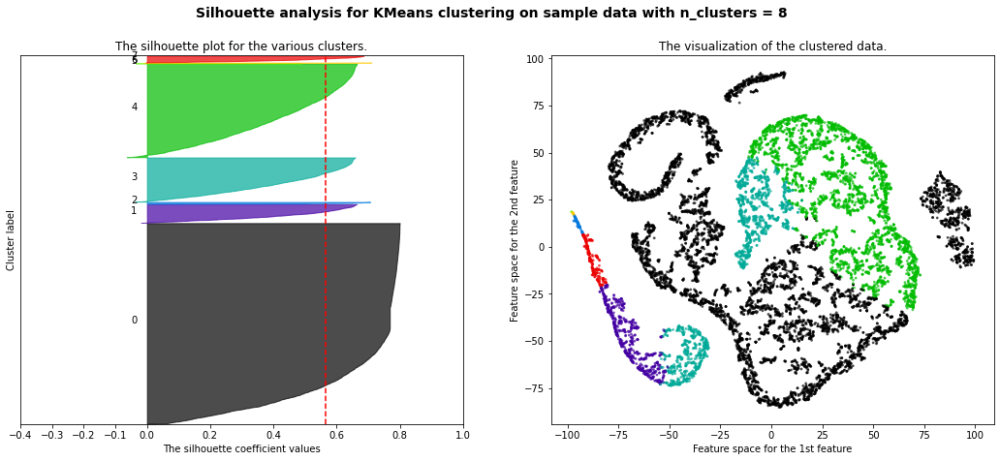

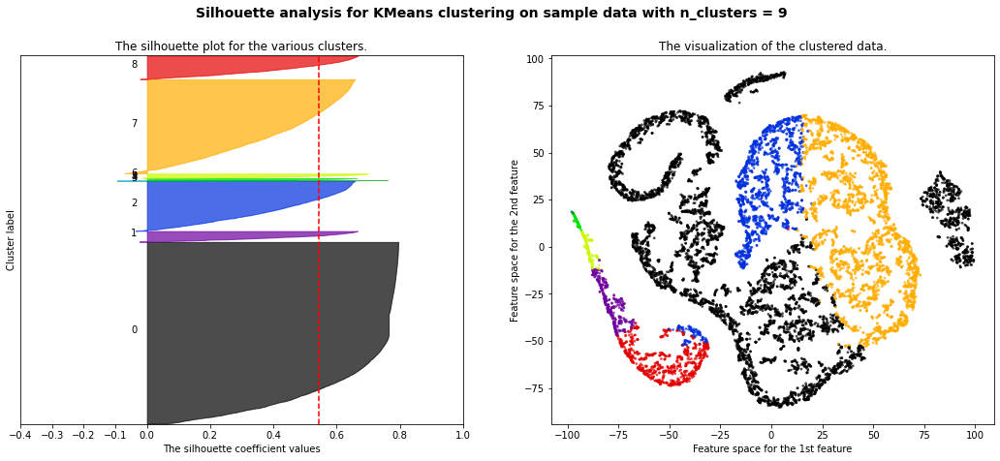

In [41]:
draw_silueat_and_klusters(df, tsne_1, 10)

In [40]:
from sklearn.decomposition import PCA
from sklearn.metrics import mean_squared_error

In [41]:
df_pca=pd.read_csv('online_shoppers_intention.csv').drop(['Month','VisitorType','Revenue','Weekend','SpecialDay','Browser','Region','OperatingSystems','TrafficType','Informational'],axis='columns')

In [42]:
err=[]
for i in range(9):
    model=PCA(n_components=i)
    m=model.fit_transform(df_pca)
    err.append([i,mean_squared_error(model.inverse_transform(m),df_pca)])


In [43]:
err

[[0, 464402.98950121435],
 [1, 5692.3652358418],
 [2, 2188.9137715025777],
 [3, 107.48239837400644],
 [4, 43.53695964814094],
 [5, 0.7530543173915849],
 [6, 0.0005229666193106379],
 [7, 2.3314419522367004e-05],
 [8, 1.7209811389265636e-24]]

In [44]:
model=PCA(n_components=6)
df2=model.fit_transform(df_pca)
df2=pd.DataFrame(df2)
df2=pd.concat([df2,encoded], axis=1)
df2=pd.concat([df2,months], axis=1)

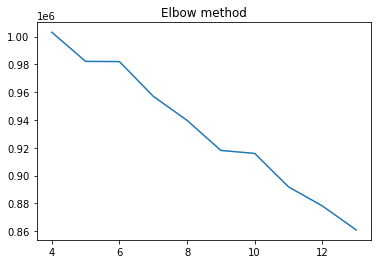

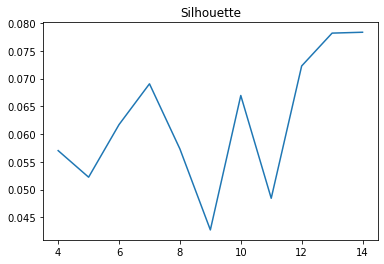

In [32]:
plots(scale(df2))

In [45]:
tsne_4=tsne.fit_transform(df2)
tsne_4=pd.DataFrame(tsne_4)

<AxesSubplot:xlabel='0', ylabel='1'>

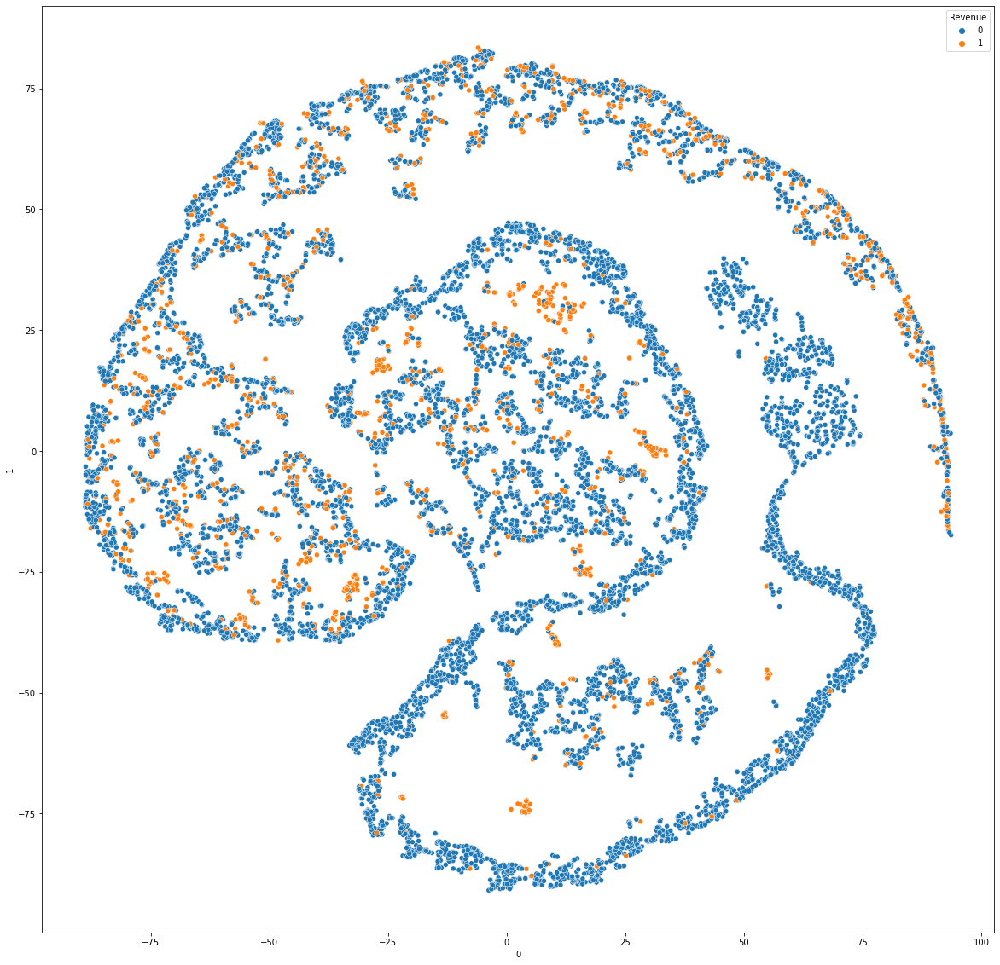

In [22]:
plt.figure(figsize=(20,20))
sns.scatterplot(x=tsne_4[0],y=tsne_4[1],hue=categorical['Revenue'])

For n_clusters = 2 The average silhouette_score is : 0.8381501109856183
For n_clusters = 3 The average silhouette_score is : 0.8016797634660693
For n_clusters = 4 The average silhouette_score is : 0.8000237333158637
For n_clusters = 5 The average silhouette_score is : 0.7167414372105253
For n_clusters = 6 The average silhouette_score is : 0.7205037134848185
For n_clusters = 7 The average silhouette_score is : 0.7197303190901472
For n_clusters = 8 The average silhouette_score is : 0.6659550245187938
For n_clusters = 9 The average silhouette_score is : 0.6744900518801925


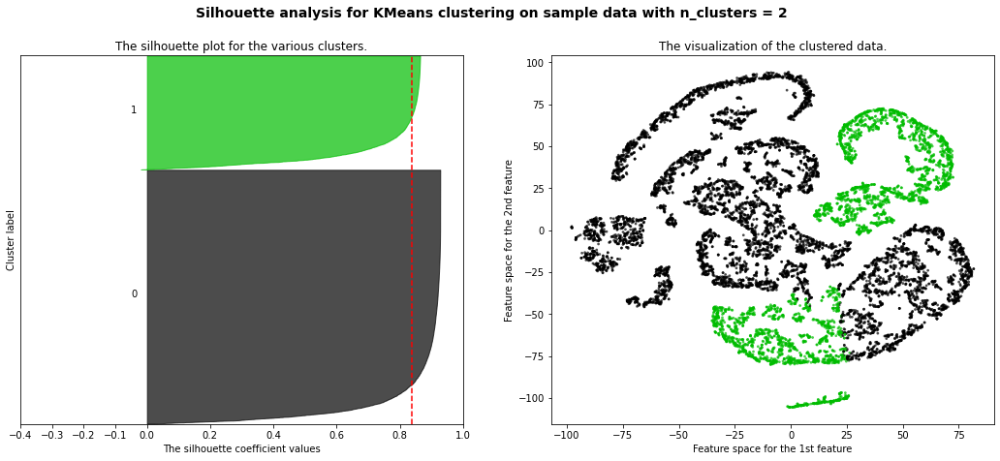

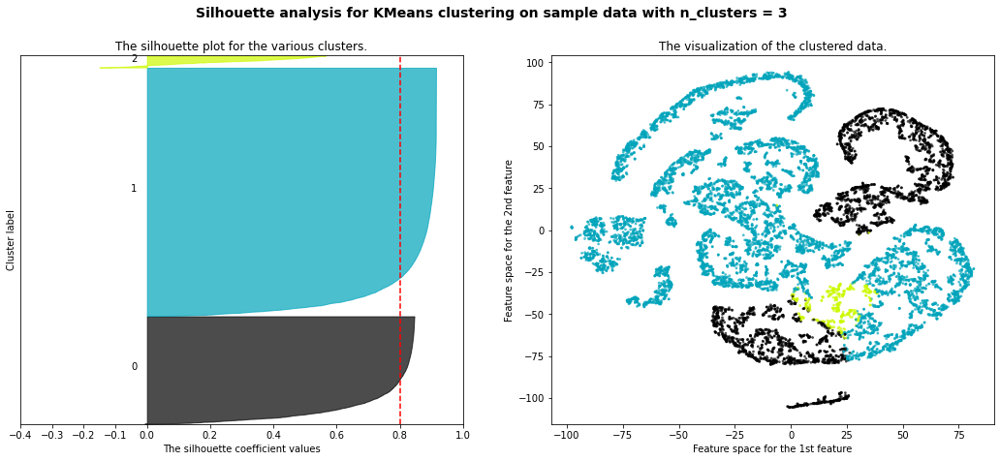

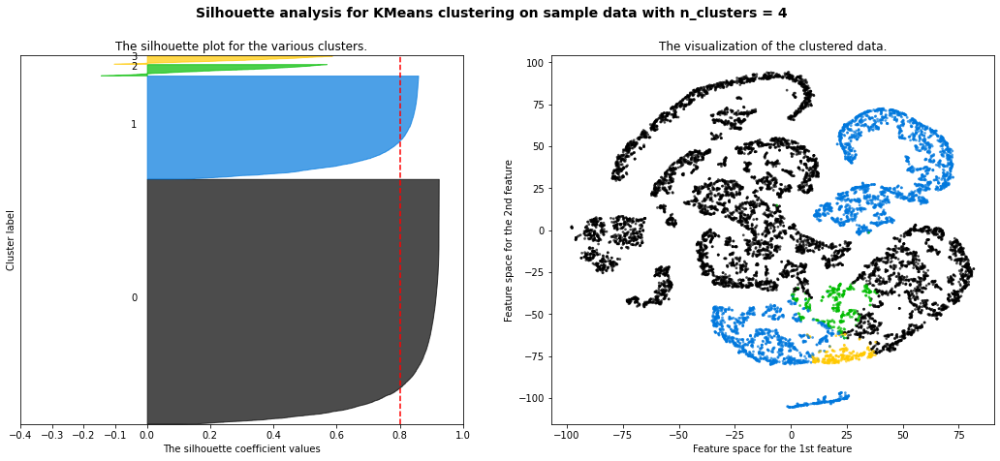

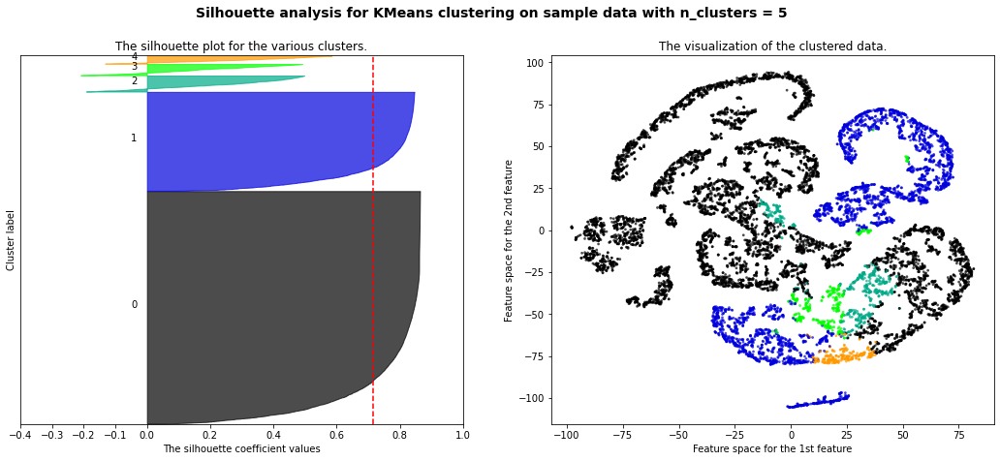

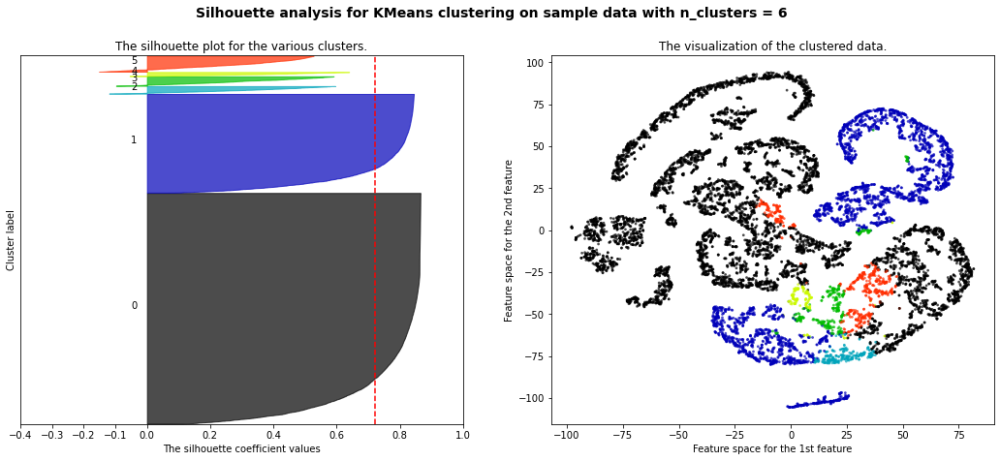

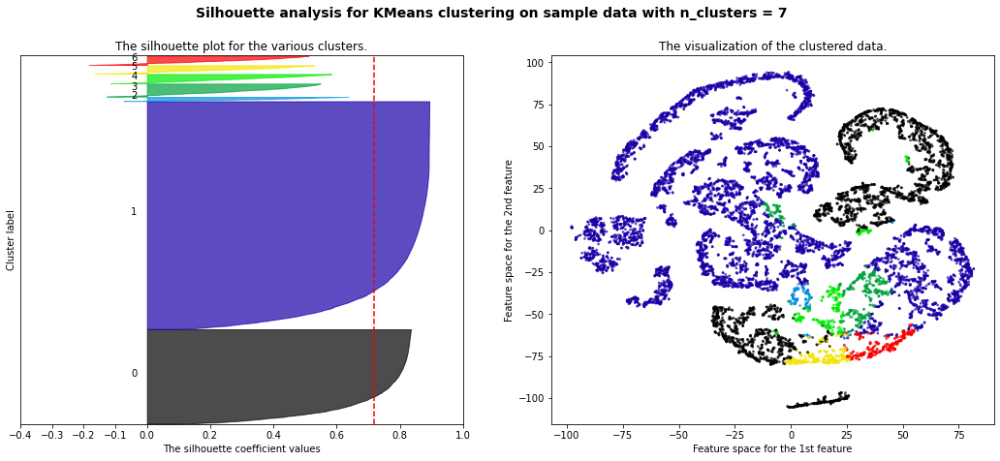

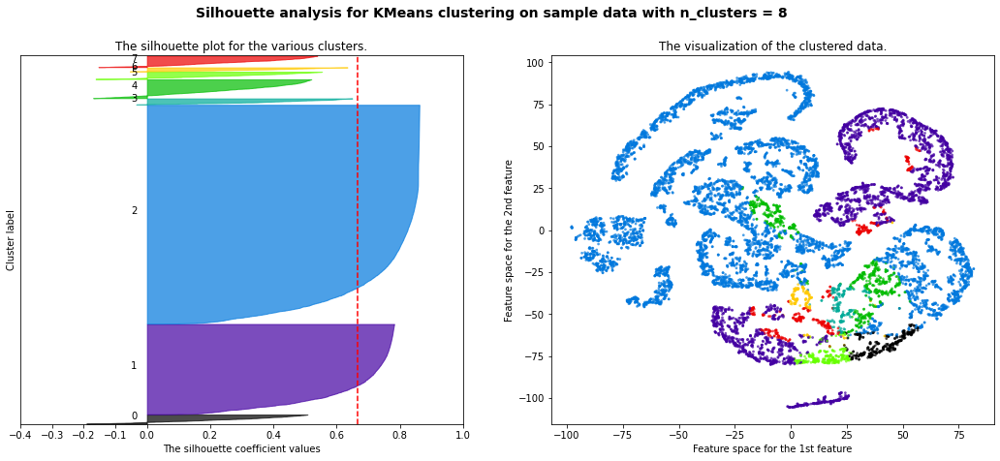

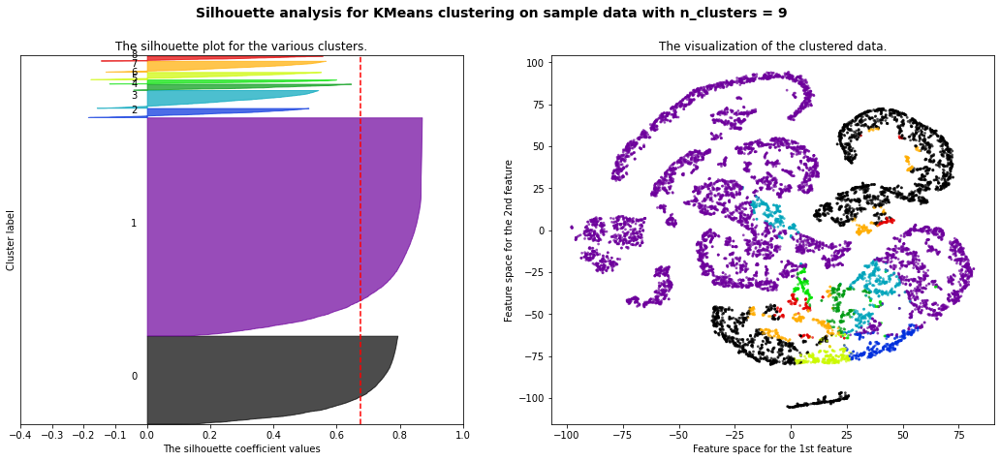

In [37]:
draw_silueat_and_klusters(normalize(df2), tsne_4, 10)

In [52]:
kmeans=KMeans(n_clusters=8, random_state=1)
fitted=kmeans.fit_predict(scaled_df)
fitted

array([2, 4, 2, ..., 6, 6, 6], dtype=int32)

In [24]:
data=pd.read_csv('online_shoppers_intention.csv')
data.Weekend=data.Weekend.astype(int)
data.Revenue=data.Revenue.astype(int)
data["VisitorType"]=data["VisitorType"].transform(lambda x: 1 if x=="Returning_Visitor" else (0 if x=="New_Visitor" else -1))
month_dict={'Jan': 1,
 'Feb': 2,
 'Mar': 3,
 'Apr': 4,
 'May': 5,
 'June': 6,
 'Jul': 7,
 'Aug': 8,
 'Sep': 9,
 'Oct': 10,
 'Nov': 11,
 'Dec': 12}
data["Month"]=data["Month"].map(month_dict)


In [40]:
data.describe()

,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,Month,OperatingSystems,Browser,Region,TrafficType,VisitorType,Weekend,Revenue
count,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000
mean,2.315166,80.818611,0.503569,34.472398,31.731468,1194.746220,0.022191,0.043073,5.889258,0.061427,7.651987,2.124006,2.357097,3.147364,4.069586,0.848824,0.232603,0.154745
std,3.321784,176.779107,1.270156,140.749294,44.475503,1913.669288,0.048488,0.048597,18.568437,0.198917,3.392841,0.911325,1.717277,2.401591,4.025169,0.376989,0.422509,0.361676
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,1.000000,1.000000,1.000000,1.000000,-1.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,7.000000,184.137500,0.000000,0.014286,0.000000,0.000000,5.000000,2.000000,2.000000,1.000000,2.000000,1.000000,0.000000,0.000000
50%,1.000000,7.500000,0.000000,0.000000,18.000000,598.936905,0.003112,0.025156,0.000000,0.000000,7.000000,2.000000,2.000000,3.000000,2.000000,1.000000,0.000000,0.000000
75%,4.000000,93.256250,0.000000,0.000000,38.000000,1464.157213,0.016813,0.050000,0.000000,0.000000,11.000000,3.000000,2.000000,4.000000,4.000000,1.000000,0.000000,0.000000
max,27.000000,3398.750000,24.000000,2549.375000,705.000000,63973.522230,0.200000,0.200000,361.763742,1.000000,12.000000,8.000000,13.000000,9.000000,20.000000,1.000000,1.000000,1.000000


In [41]:
for i in range(8):
    print(f"{i}:  {np.mean(data[fitted==i]['Revenue'])}")

0:  0.8483870967741935
1:  0.12728719172633254
2:  0.21655024180548094
3:  0.346723044397463
4:  0.05732778548312529
5:  0.25766871165644173
6:  0.0043859649122807015
7:  0.20098039215686275


In [23]:
data[fitted==5].describe()

,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,Month,OperatingSystems,Browser,Region,TrafficType,VisitorType,Weekend,Revenue
count,625.000000,625.000000,625.000000,625.000000,625.000000,625.000000,625.000000,625.000000,625.000000,625.000000,625.000000,625.000000,625.00000,625.000000,625.000000,625.000000,625.000000,625.000000
mean,2.192000,71.128263,0.441600,21.368782,29.086400,1128.132445,0.002563,0.014479,68.181923,0.013760,8.368000,2.140800,2.60640,3.190400,4.259200,0.624000,0.243200,0.848000
std,2.624148,112.069575,1.068277,68.254267,25.874554,958.936485,0.006832,0.011616,41.258968,0.088449,3.225837,1.137649,2.26072,2.493049,4.318269,0.525991,0.429358,0.359308
min,0.000000,0.000000,0.000000,0.000000,1.000000,15.600000,0.000000,0.000000,29.902821,0.000000,2.000000,1.000000,1.00000,1.000000,1.000000,-1.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,13.000000,481.833333,0.000000,0.006250,44.611999,0.000000,5.000000,2.000000,2.00000,1.000000,2.000000,0.000000,0.000000,1.000000
50%,1.000000,33.200000,0.000000,0.000000,21.000000,865.000000,0.000000,0.012346,55.899789,0.000000,10.000000,2.000000,2.00000,3.000000,2.000000,1.000000,0.000000,1.000000
75%,3.000000,96.250000,0.000000,0.000000,36.000000,1443.641667,0.000000,0.020000,77.457985,0.000000,11.000000,2.000000,2.00000,4.000000,4.000000,1.000000,0.000000,1.000000
max,16.000000,900.500000,7.000000,594.133333,184.000000,5972.416667,0.054545,0.075000,361.763742,1.000000,12.000000,8.000000,13.00000,9.000000,20.000000,1.000000,1.000000,1.000000


In [27]:
for i in range(8):
    print(f"{i}:  {np.min(data[fitted==i]['VisitorType'])}")

0:  -1
1:  0
2:  -1
3:  -1
4:  0
5:  -1
6:  -1
7:  -1


In [25]:
data[fitted==0].describe()

,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,Month,OperatingSystems,Browser,Region,TrafficType,VisitorType,Weekend,Revenue
count,1837.000000,1837.000000,1837.000000,1837.000000,1837.000000,1837.000000,1837.000000,1837.000000,1837.000000,1837.000000,1837.000000,1837.000000,1837.000000,1837.000000,1837.000000,1837.000000,1837.000000,1837.000000
mean,7.191617,229.320067,1.123027,53.720143,44.550354,1580.832938,0.006226,0.019605,6.476691,0.029178,7.859009,2.095264,2.227545,3.180729,3.808928,0.845944,0.248775,0.216658
std,2.906359,150.125977,1.622318,97.963575,29.664542,1158.209286,0.008938,0.012835,10.366919,0.139005,3.231153,0.832460,1.479137,2.362331,3.624079,0.370040,0.432421,0.412080
min,1.000000,11.923077,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,1.000000,1.000000,1.000000,1.000000,-1.000000,0.000000,0.000000
25%,5.000000,119.400000,0.000000,0.000000,22.000000,668.033333,0.000000,0.010539,0.000000,0.000000,5.000000,2.000000,2.000000,1.000000,2.000000,1.000000,0.000000,0.000000
50%,7.000000,188.532234,0.000000,0.000000,37.000000,1352.816503,0.003200,0.017333,0.000000,0.000000,8.000000,2.000000,2.000000,3.000000,2.000000,1.000000,0.000000,0.000000
75%,9.000000,299.083333,2.000000,62.500000,62.000000,2207.391667,0.009091,0.025541,10.024706,0.000000,11.000000,3.000000,2.000000,4.000000,4.000000,1.000000,0.000000,0.000000
max,23.000000,785.216667,12.000000,506.000000,160.000000,6483.775000,0.079279,0.090963,54.951269,1.000000,12.000000,8.000000,13.000000,9.000000,20.000000,1.000000,1.000000,1.000000


  0%|          | 0/5 [00:00<?, ?it/s]

5


 20%|██        | 1/5 [00:29<01:58, 29.70s/it]

6


 40%|████      | 2/5 [01:01<01:31, 30.41s/it]

7


 60%|██████    | 3/5 [01:37<01:04, 32.11s/it]

8


 80%|████████  | 4/5 [02:17<00:34, 34.26s/it]

9


100%|██████████| 5/5 [02:58<00:00, 35.69s/it]


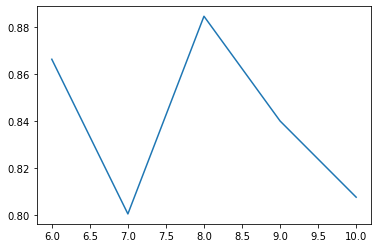

In [39]:
vec=[]
vec1=[]
for i in tqdm(range(5,10,1)):
    n_clusters=i+1
    print(i)
    vec.append(kmeans_stability_mean(normalize(df2),n_clusters))
    vec1.append(n_clusters)
plt.plot(vec1,vec)
plt.show()

### Porównanie wielkości klastrów

### scaled

In [55]:
size_scaled = [0] * 8 
clasters = range(0,8)
for i in range(8):
    size_scaled[i] = data[fitted==i].shape[0]/data.shape[0]*100
    print(data[fitted==i].shape[0]/data.shape[0]*100)

15.093268450932683
3.8361719383617197
7.3965936739659375
1.2976480129764802
35.11759935117599
4.963503649635037
30.640713706407137
1.654501216545012


<BarContainer object of 8 artists>

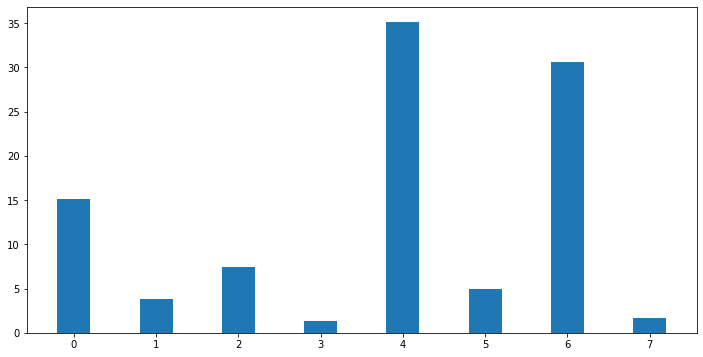

In [62]:
plt.figure(figsize=(12,6))
plt.bar(clasters, size_scaled,
        width = 0.4)

### normalize(df2)

In [65]:
kmeans=KMeans(n_clusters=8)
kmeans.fit(normalize(df2))
fitted1=kmeans.predict(normalize(df2))
size_scaled1 = [0] * 8 
clasters = range(0,8)
for i in range(8):
    size_scaled1[i] = data[fitted1==i].shape[0]/data.shape[0]*100
    print(data[fitted1==i].shape[0]/data.shape[0]*100)

59.83779399837794
3.0819140308191404
1.662611516626115
1.103000811030008
5.1338199513382
2.506082725060827
24.679643146796433
1.995133819951338


<BarContainer object of 8 artists>

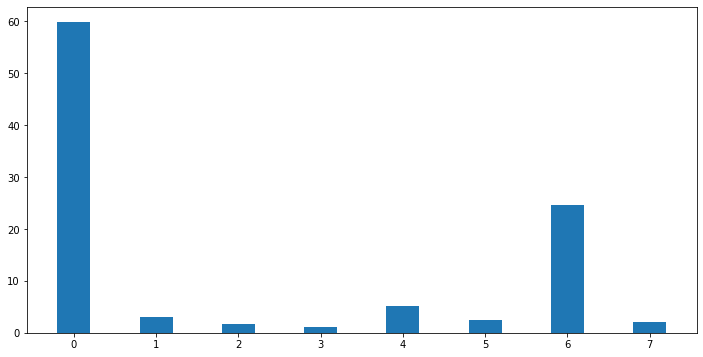

In [66]:
plt.figure(figsize=(12,6))
plt.bar(clasters, size_scaled1,
        width = 0.4)

### scaled

In [43]:
from scipy.spatial import distance
import numpy as np


def min_interclust_dist(X, label):
    clusters = set(label)
    global_min_dist = np.inf
    for cluster_i in clusters:
        cluster_i_idx = np.where(label == cluster_i)
        for cluster_j in clusters:
            if cluster_i != cluster_j:
                cluster_j_idx = np.where(label == cluster_j)
                interclust_min_dist = np.min(distance.cdist(X[cluster_i_idx], X[cluster_j_idx]))
                global_min_dist = np.min([global_min_dist, interclust_min_dist])
    return global_min_dist

def _inclust_mean_dists(X, label):
    clusters = set(label)
    inclust_dist_list = []
    for cluster_i in clusters:
        cluster_i_idx = np.where(label == cluster_i)
        inclust_dist = np.mean(distance.pdist(X[cluster_i_idx]))
        inclust_dist_list.append(inclust_dist)
    return inclust_dist_list

def mean_inclust_dist(X, label):
    inclust_dist_list = _inclust_mean_dists(X, label)
    return np.mean(inclust_dist_list)

def std_dev_of_inclust_dist(X, label):
    inclust_dist_list = _inclust_mean_dists(X, label)
    return np.std(inclust_dist_list)

def mean_dist_to_center(X, label):
    clusters = set(label)
    inclust_dist_list = []
    for cluster_i in clusters:
        cluster_i_idx = np.where(label == cluster_i)
        cluster_i_mean = np.mean(X[cluster_i_idx], axis=0, keepdims=True)
        inclust_dist = np.mean(distance.cdist(X[cluster_i_idx], cluster_i_mean))
        inclust_dist_list.append(inclust_dist)
    return np.mean(inclust_dist_list)


print(f'Minimal distance between clusters = {count_clustering_scores(np.array(scaled_df), 8, KMeans, min_interclust_dist):.2f}.')
print(f'Average distance between points in the same class = '
      f'{count_clustering_scores(np.array(scaled_df), 8, KMeans, mean_inclust_dist):.2f}.')
print(f'Standard deviation of distance between points in the same class = '
      f'{count_clustering_scores(np.array(scaled_df), 8, KMeans, std_dev_of_inclust_dist):.3f}.')
print(f'Average distance to cluster center = '
      f'{count_clustering_scores(np.array(scaled_df), 8, KMeans, mean_dist_to_center):.2f}.')


Minimal distance between clusters = 0.21.
Average distance between points in the same class = 4.56.
Standard deviation of distance between points in the same class = 1.325.
Average distance to cluster center = 3.19.


### normalize(df2)

In [44]:
print(f'Minimal distance between clusters = {count_clustering_scores(np.array(normalize(df2)), 8, KMeans, min_interclust_dist):.2f}.')
print(f'Average distance between points in the same class = '
      f'{count_clustering_scores(np.array(normalize(df2)), 8, KMeans, mean_inclust_dist):.2f}.')
print(f'Standard deviation of distance between points in the same class = '
      f'{count_clustering_scores(np.array(normalize(df2)), 8, KMeans, std_dev_of_inclust_dist):.3f}.')
print(f'Average distance to cluster center = '
      f'{count_clustering_scores(np.array(normalize(df2)), 8, KMeans, mean_dist_to_center):.2f}.')

Minimal distance between clusters = 0.00.
Average distance between points in the same class = 0.41.
Standard deviation of distance between points in the same class = 0.182.
Average distance to cluster center = 0.29.


### Szukanie charakterystycznych cech dla klastrów 

In [46]:
data[fitted1==0].describe()

,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,Month,OperatingSystems,Browser,Region,TrafficType,VisitorType,Weekend,Revenue
count,7382.000000,7382.000000,7382.000000,7382.000000,7382.000000,7382.000000,7382.000000,7382.000000,7382.000000,7382.000000,7382.000000,7382.000000,7382.000000,7382.000000,7382.000000,7382.000000,7382.000000,7382.000000
mean,1.137090,24.268833,0.184638,7.875744,12.727174,330.283405,0.031684,0.056428,4.194688,0.069575,7.295313,2.120699,2.367109,3.154294,4.222839,0.816445,0.225955,0.106069
std,1.931536,42.817882,0.664722,41.989861,11.117754,288.291933,0.060009,0.057381,17.046267,0.210221,3.421566,0.961490,1.786806,2.409372,4.139461,0.409924,0.418238,0.307947
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,1.000000,1.000000,1.000000,1.000000,-1.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,4.000000,78.137500,0.000000,0.016667,0.000000,0.000000,5.000000,2.000000,2.000000,1.000000,2.000000,1.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,10.000000,257.408333,0.000000,0.033333,0.000000,0.000000,6.000000,2.000000,2.000000,3.000000,3.000000,1.000000,0.000000,0.000000
75%,2.000000,35.150000,0.000000,0.000000,18.000000,533.650000,0.028571,0.066754,0.000000,0.000000,11.000000,3.000000,2.000000,4.000000,4.000000,1.000000,0.000000,0.000000
max,15.000000,234.300000,7.000000,801.800000,90.000000,1150.192063,0.200000,0.200000,361.763742,1.000000,12.000000,8.000000,13.000000,9.000000,20.000000,1.000000,1.000000,1.000000


In [ ]:
-raczej nie kupują
-raczej na tygodniu/ w zwykły dzień
-raczej powracający visitor


In [47]:
import seaborn as sns

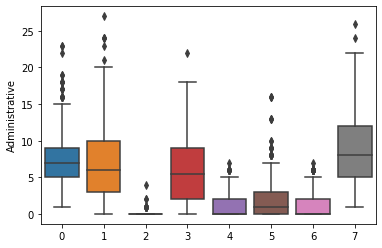

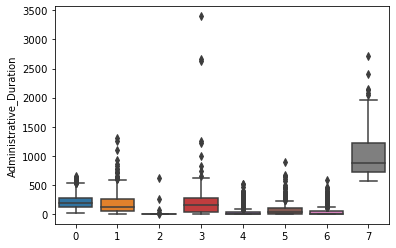

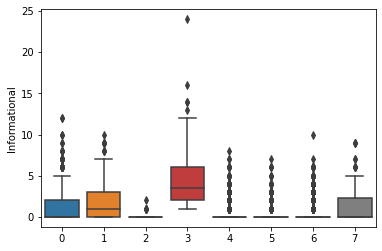

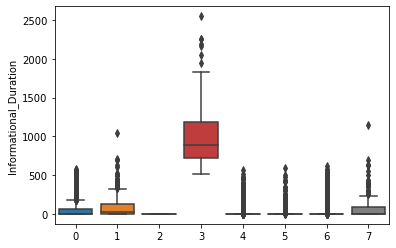

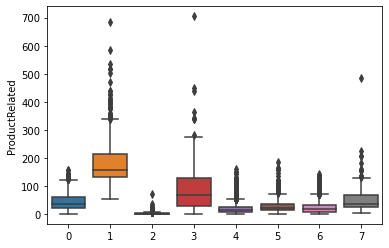

...

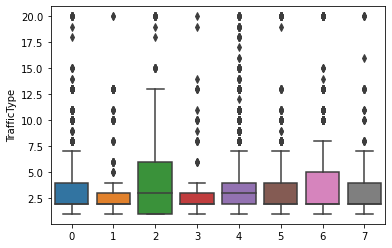

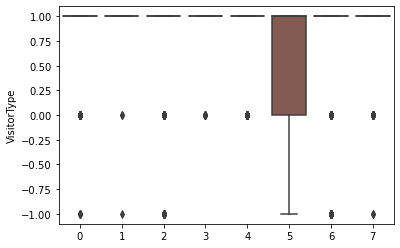

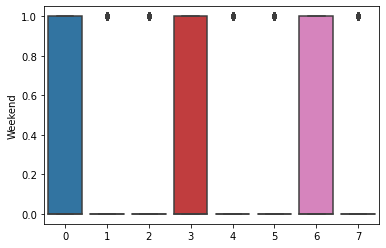

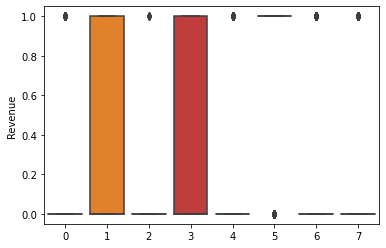

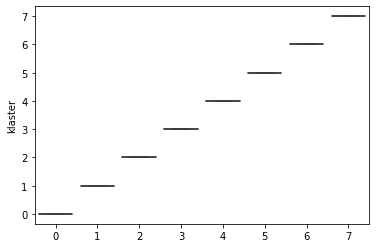

In [33]:
for col in data.columns:
    sns.boxplot(data=data, x=fitted, y=data[col])
    plt.show()

In [ ]:
3) ci co szukają czegoś nas święta, ale nic nie kupują, często w weekendy
4) weekendy, dosyć często kupują, wyższe informational duration
5) njowi albo  wracający, kupujący , wysokie apge values


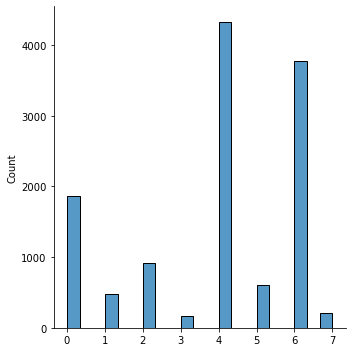

In [68]:
sns.displot(data=data, x=fitted)

In [26]:
szymon_dane = data[fitted > 3]
szymon_dane["klaster"] = fitted[fitted > 3]

<ipython-input-26-682da191cba3>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  szymon_dane["klaster"] = fitted[fitted > 3]


Gęstości dla  Administrative


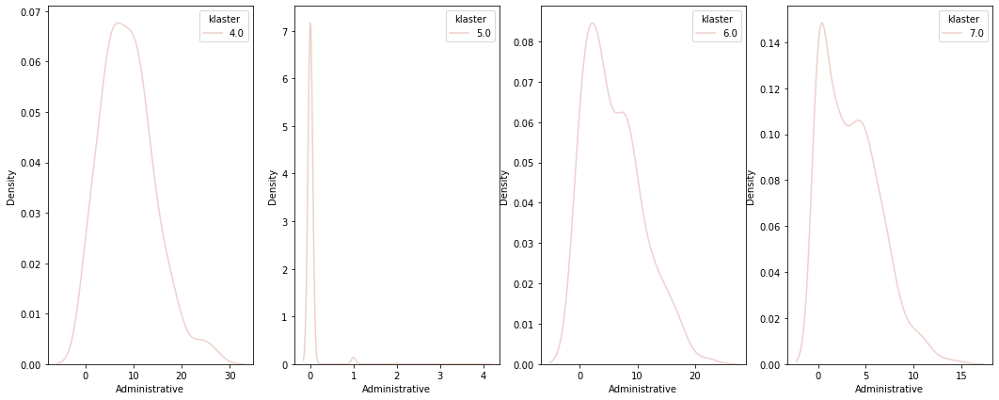

Gęstości dla  Administrative_Duration


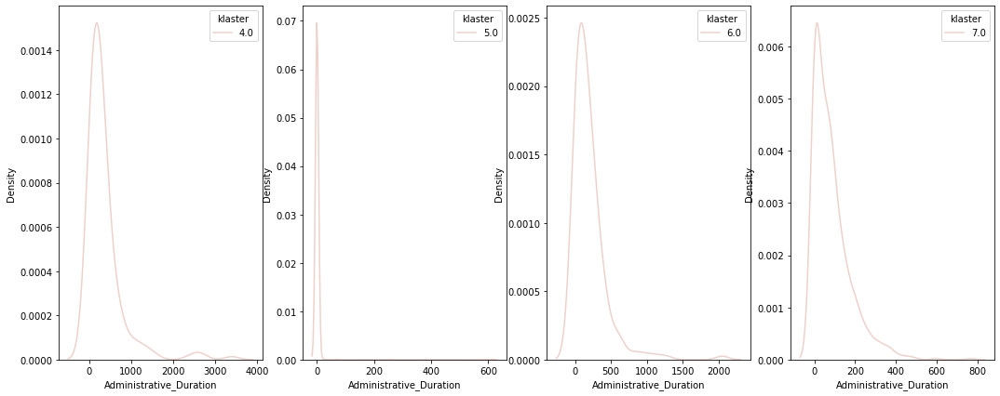

Gęstości dla  Informational


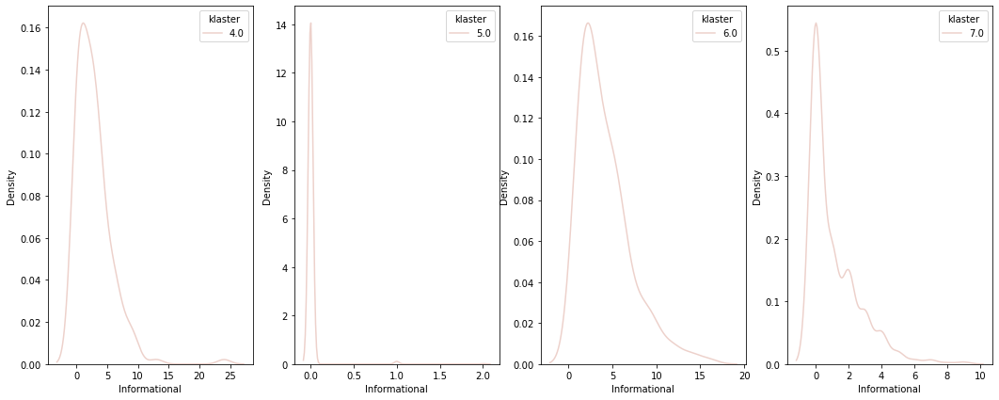

Gęstości dla  Informational_Duration


/Users/szymonszmajdzinski/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:305: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


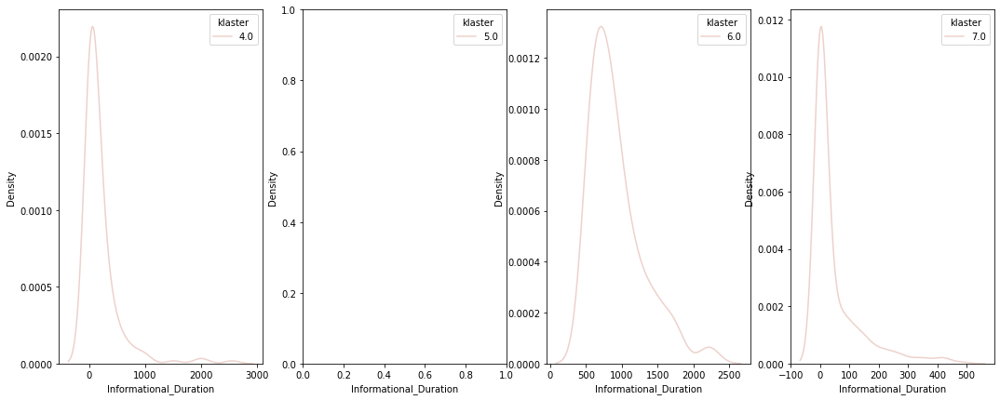

Gęstości dla  ProductRelated


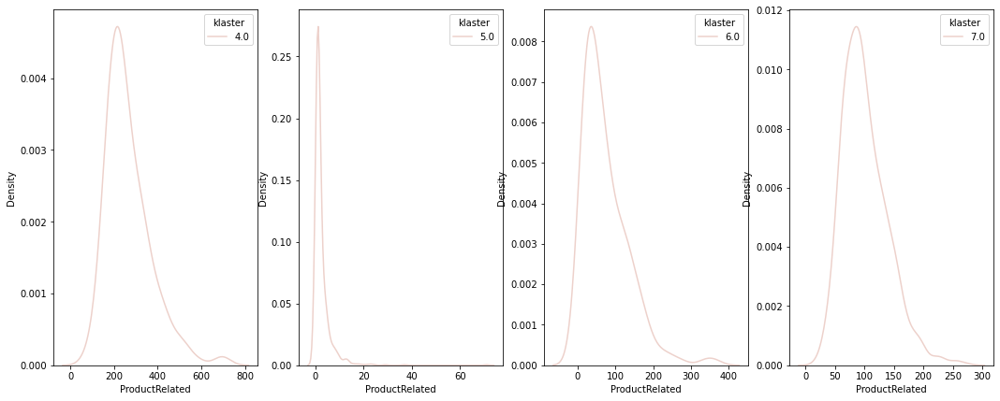

Gęstości dla  ProductRelated_Duration


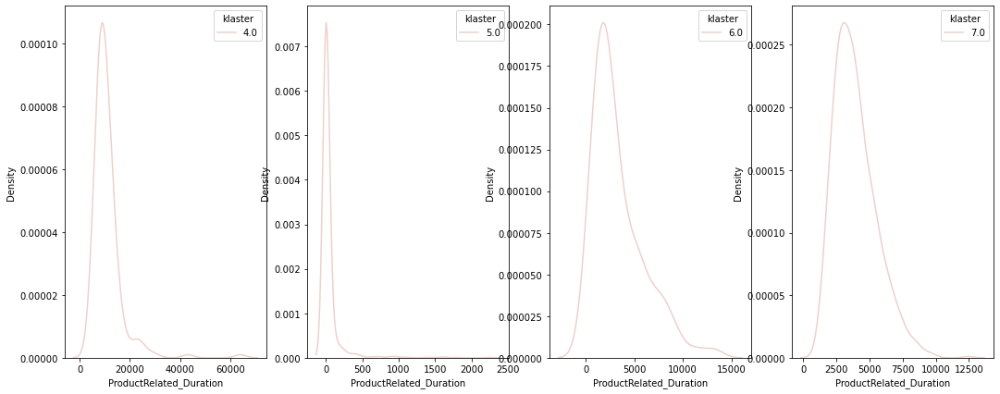

Gęstości dla  BounceRates


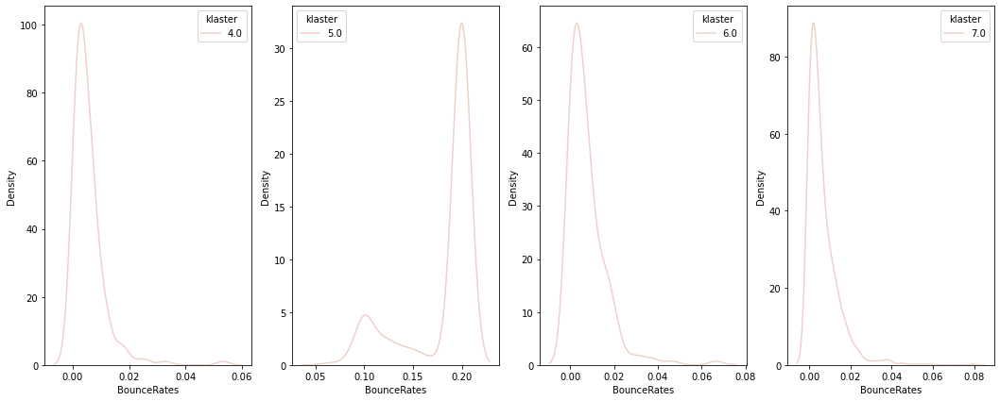

Gęstości dla  ExitRates


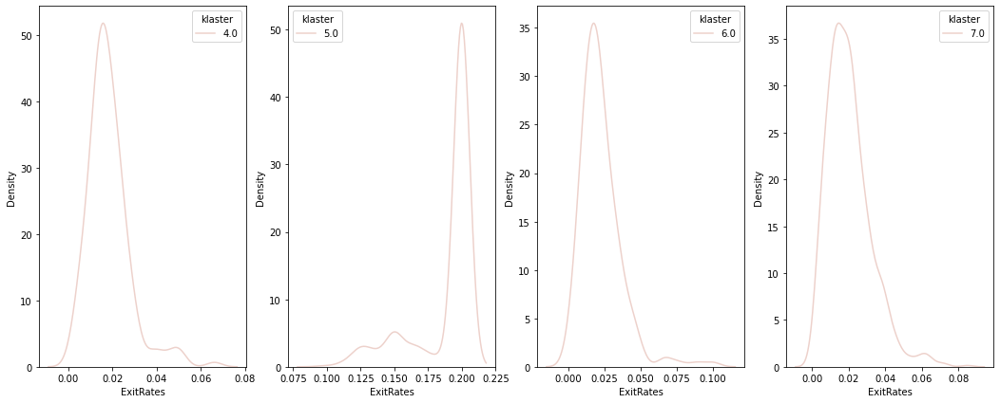

Gęstości dla  PageValues


/Users/szymonszmajdzinski/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:305: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


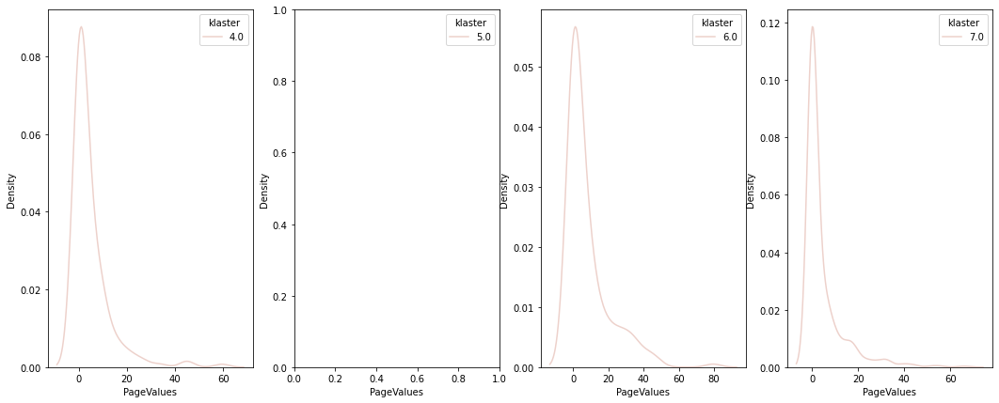

Gęstości dla  SpecialDay


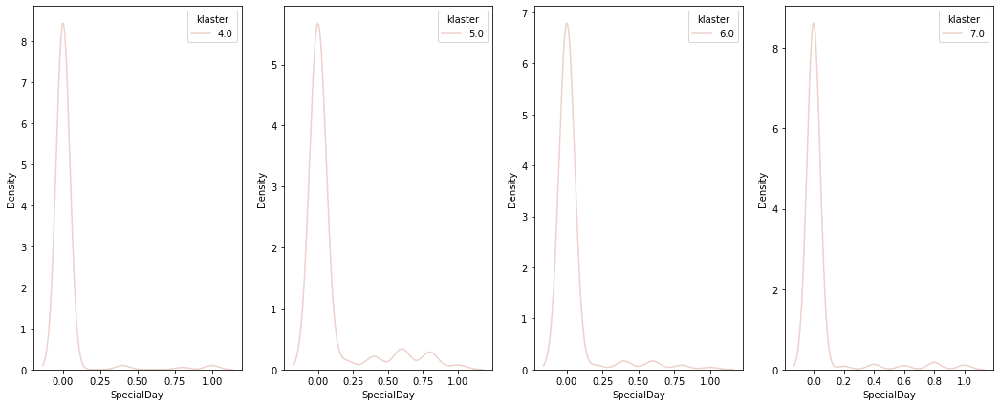

Gęstości dla  Month


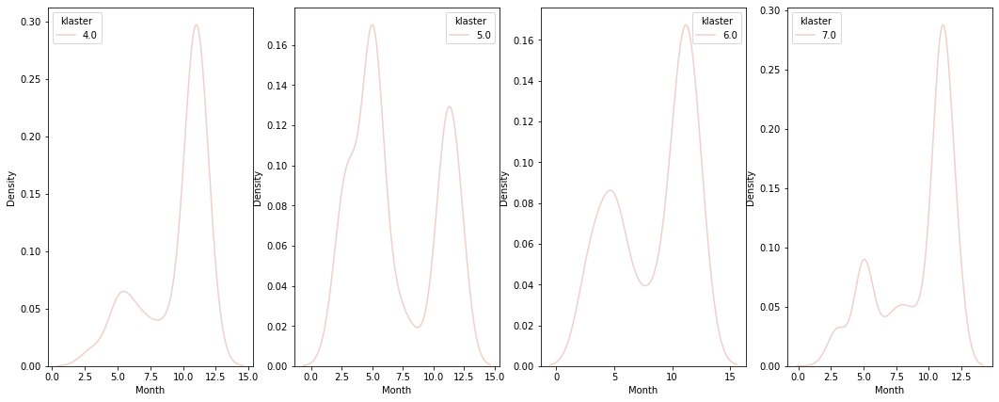

Gęstości dla  OperatingSystems


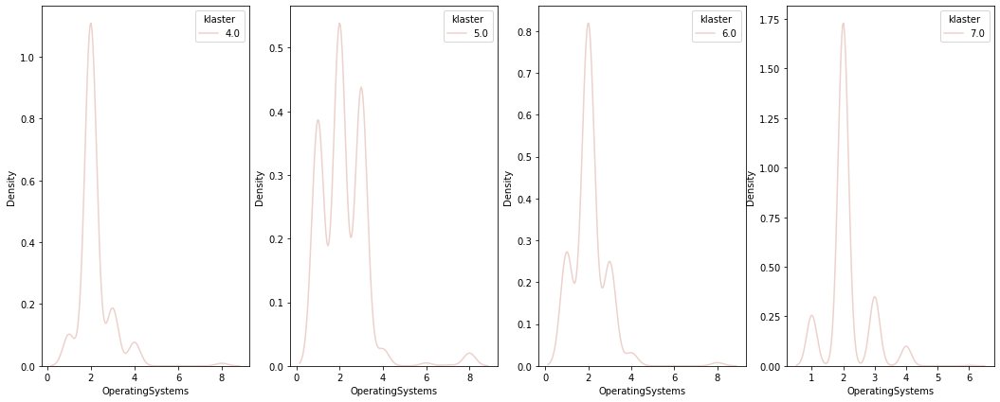

Gęstości dla  Browser


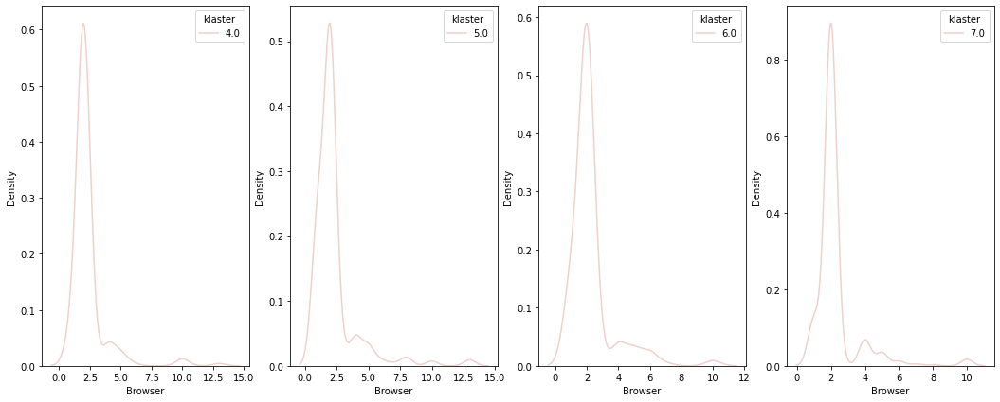

Gęstości dla  Region


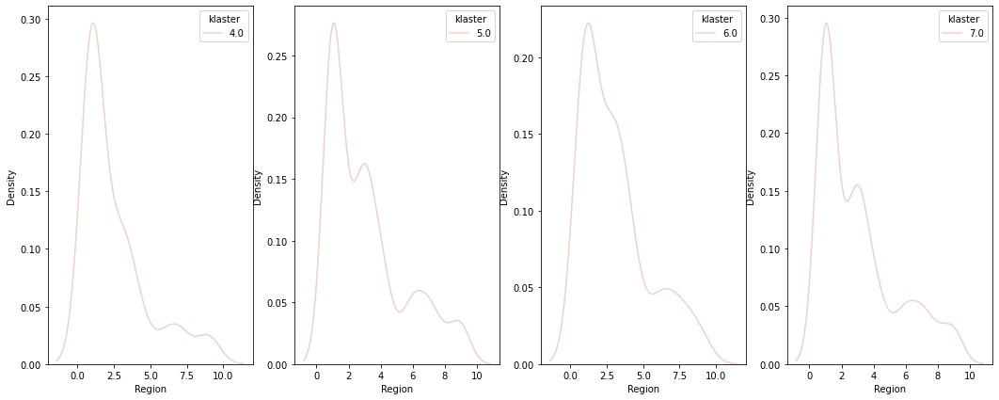

Gęstości dla  TrafficType


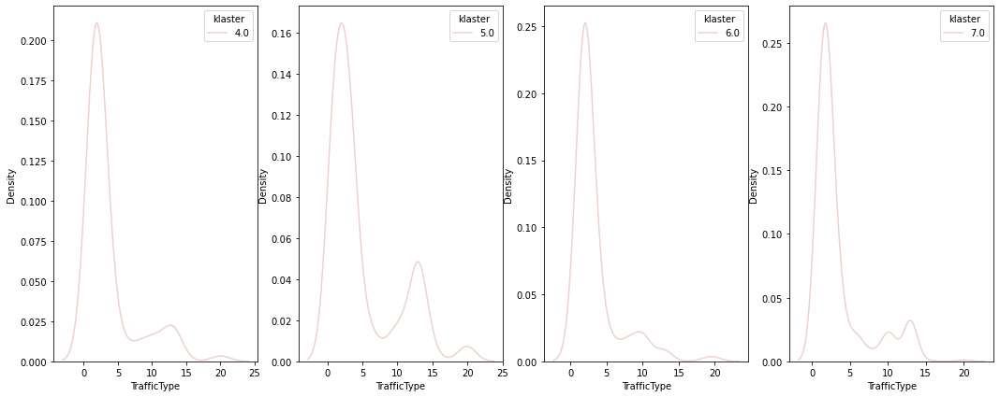

Gęstości dla  VisitorType


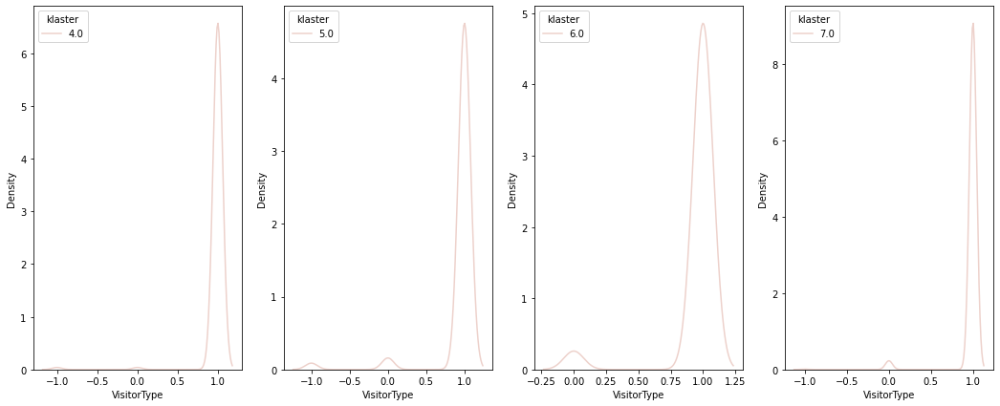

Gęstości dla  Weekend


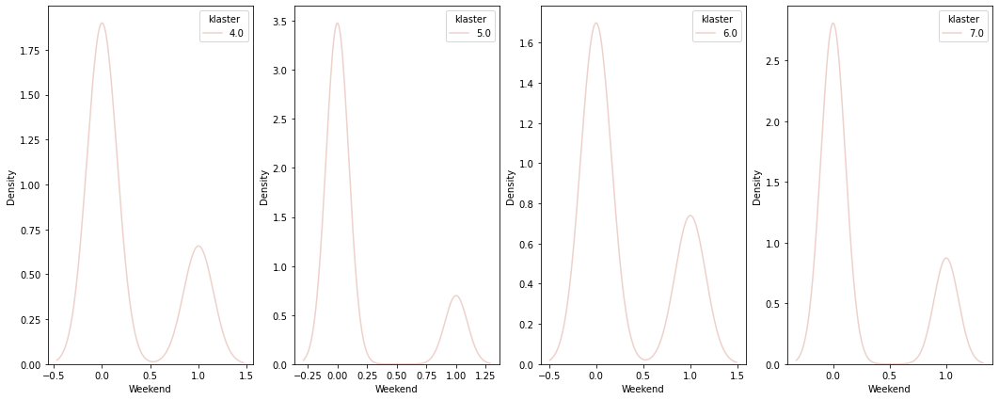

Gęstości dla  Revenue


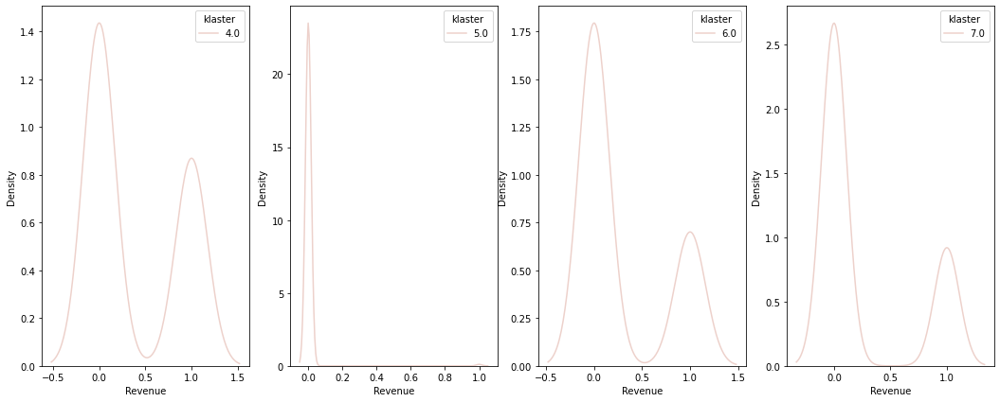

Gęstości dla  klaster


/Users/szymonszmajdzinski/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:305: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/Users/szymonszmajdzinski/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:305: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/Users/szymonszmajdzinski/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:305: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/Users/szymonszmajdzinski/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:305: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


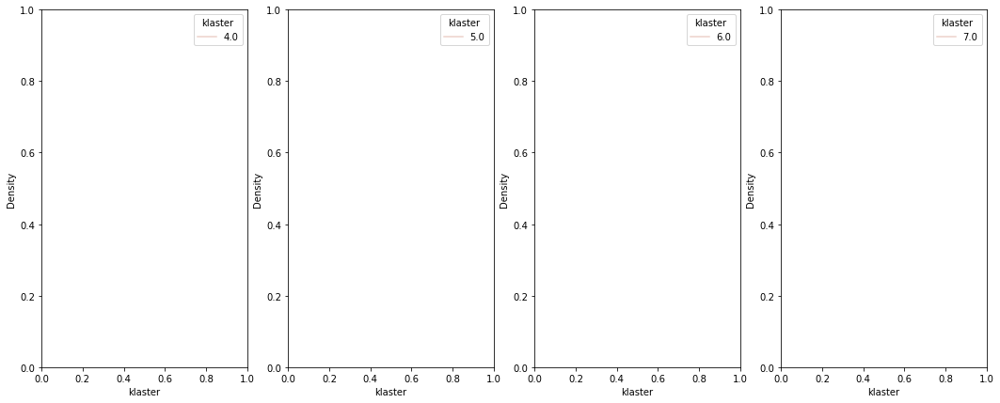

In [27]:
for col in szymon_dane.columns:
    fig, axs = plt.subplots(ncols=4)
    fig.set_size_inches(18, 7)
    print("Gęstości dla ", col)
    for i in range(4,8):
        sns.kdeplot(data=szymon_dane[szymon_dane.klaster == i], x=szymon_dane[col], hue = "klaster", ax=axs[i-4])
    plt.show()


### Wnioski dla 4,5,6,7
4. Klasyczny użytkownik - Najliczniejsza grupa. Nie wchodzi na strony administracyjne i informacyjne. Najwięcej czasu spędza na stronach z produktami. Korzysta z najpopularniejszych systemów operacyjnych i przeglądarek. Najwięcej zakupów robi w okolicach marca i maja (co jest odmienne). Być może robi zakupy wiosenne i letnie
5. Researcher - Spędza najwięcej czasu na stonach informacyjnych w porównaniu do innych klastrów, oraz ma najwyższy odsetek revenue. Używa praktycznie tylko przeglądarki nr 2. Porównywalnie dużo czasu na stronach informacyjnych i z produktami.
6. Uciekacz - Zdecydowanie wyróżnia się największym exit i bounce ratem. Tylko zerka na strony z produktami na inne prektycznie nie wchodzi. Praktycznie nic nie kupuje. Być może wchodzi na strony przez przypadek? Używa mniej popularnych systemów operacyjnych. Ma inny  ruch sieciowy niż inne klastry (podejrzanie dużo 14?13?)
7. Administrowicz - Wyróżnia się tym, że spędza najwięcej czasu na stronach administracyjnych. Rozkład regionu tej grupy jest bardzo podobny do rozkładu Researchera. Całkiem sporo kupuje. Ma duży odsetek klientów typu 0.

In [51]:
fitted

array([6, 4, 6, ..., 1, 1, 1], dtype=int32)

Gęstości dla  Administrative


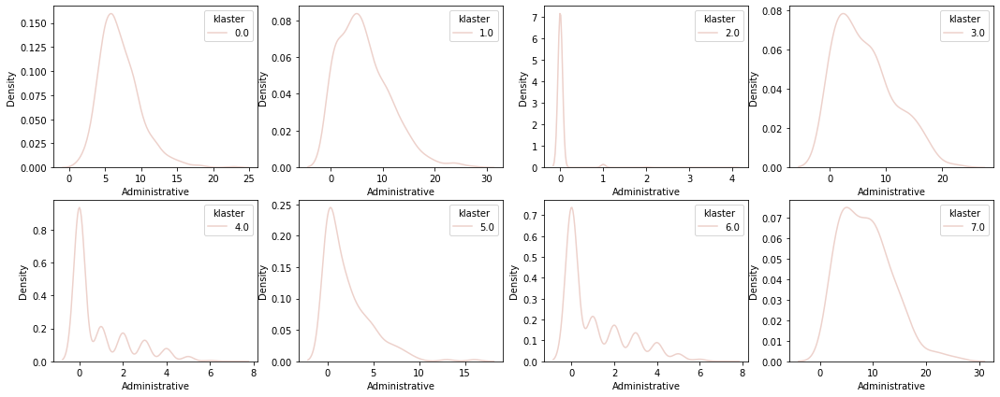

Gęstości dla  Administrative_Duration


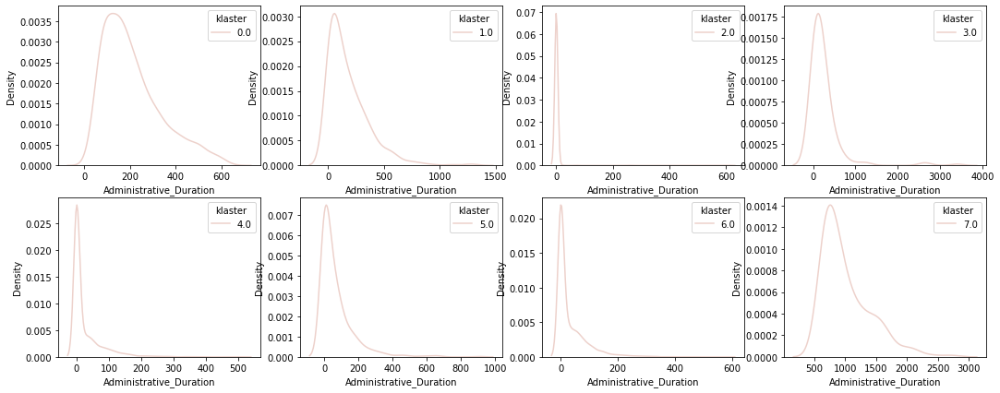

Gęstości dla  Informational


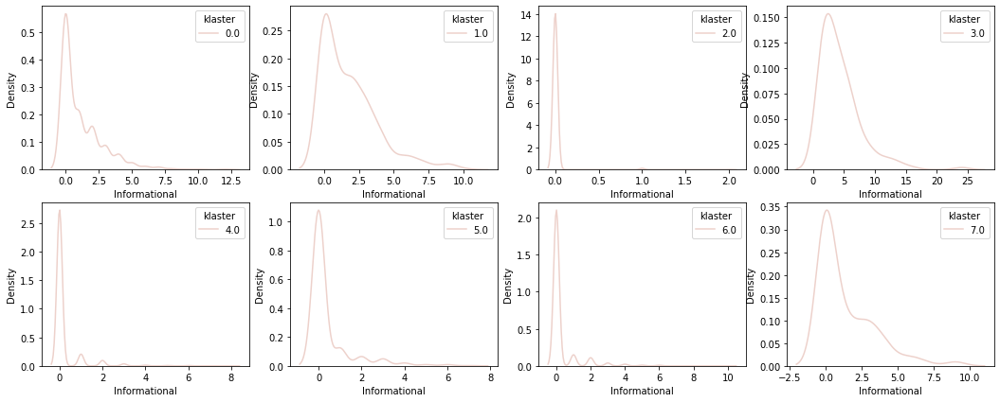

Gęstości dla  Informational_Duration


/Users/szymonszmajdzinski/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:305: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


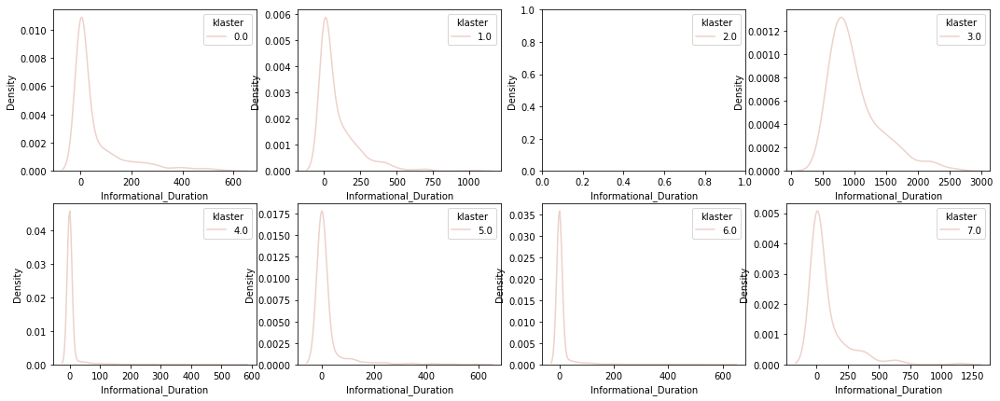

Gęstości dla  ProductRelated


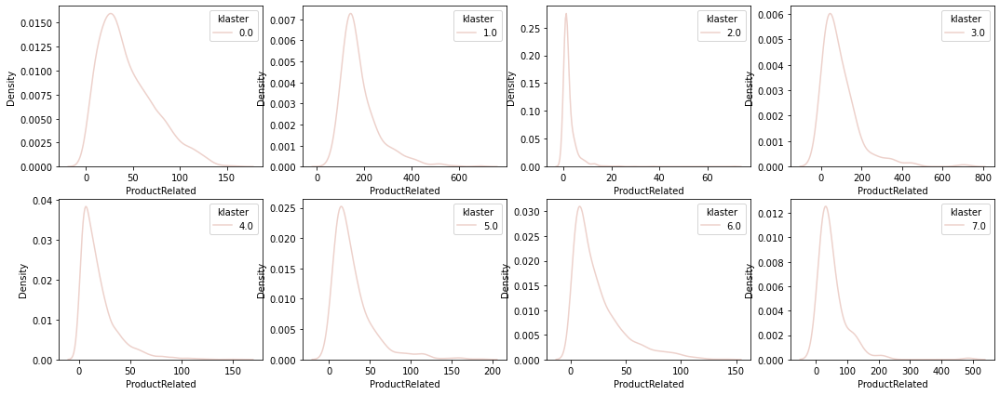

Gęstości dla  ProductRelated_Duration


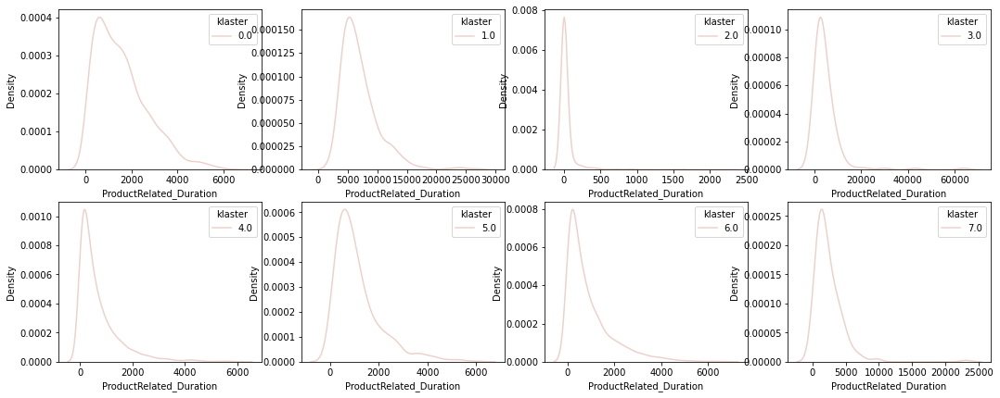

Gęstości dla  BounceRates


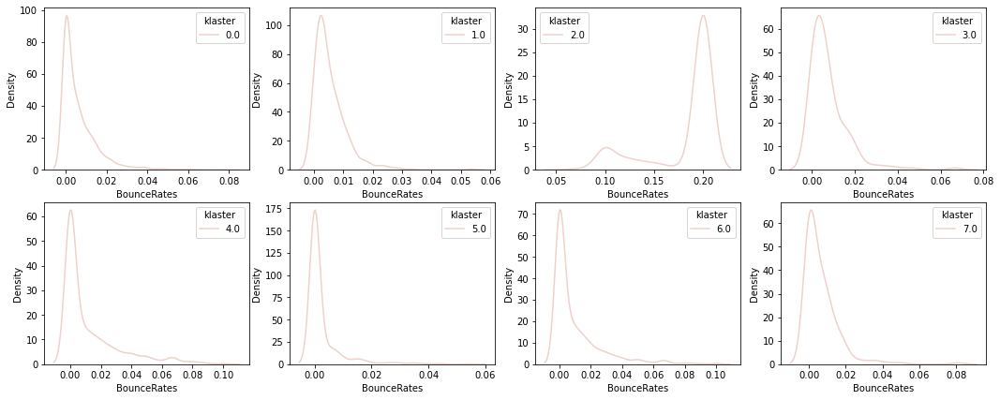

Gęstości dla  ExitRates


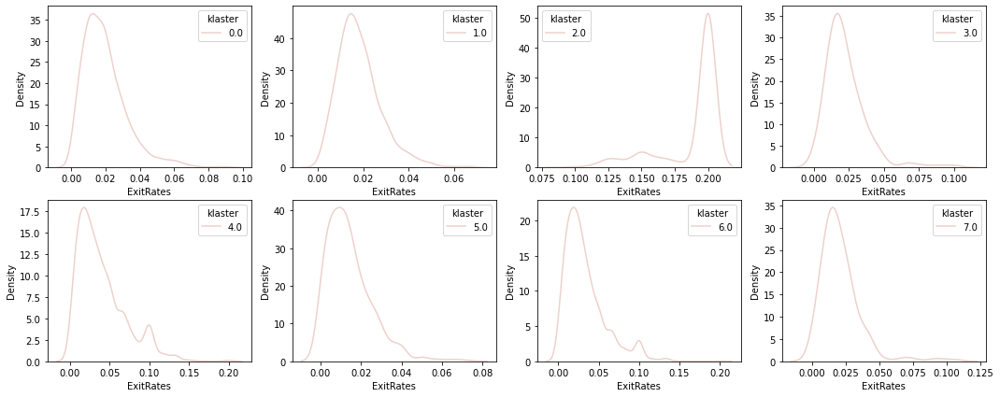

Gęstości dla  PageValues


/Users/szymonszmajdzinski/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:305: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


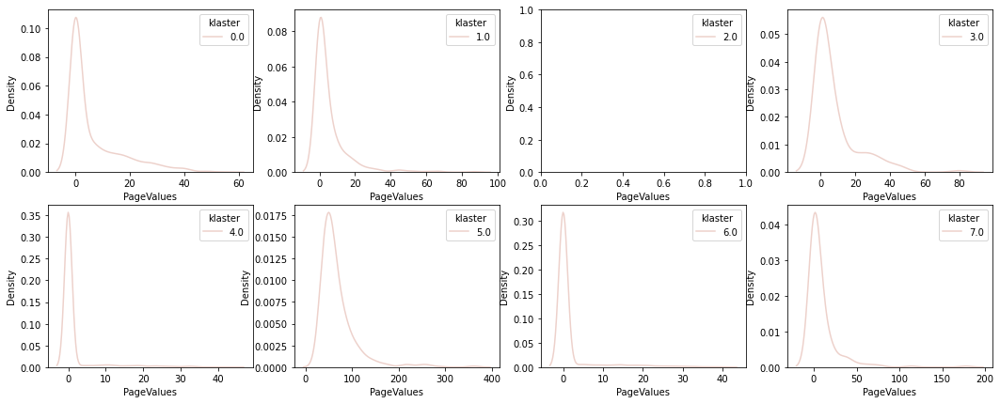

Gęstości dla  SpecialDay


/Users/szymonszmajdzinski/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:305: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


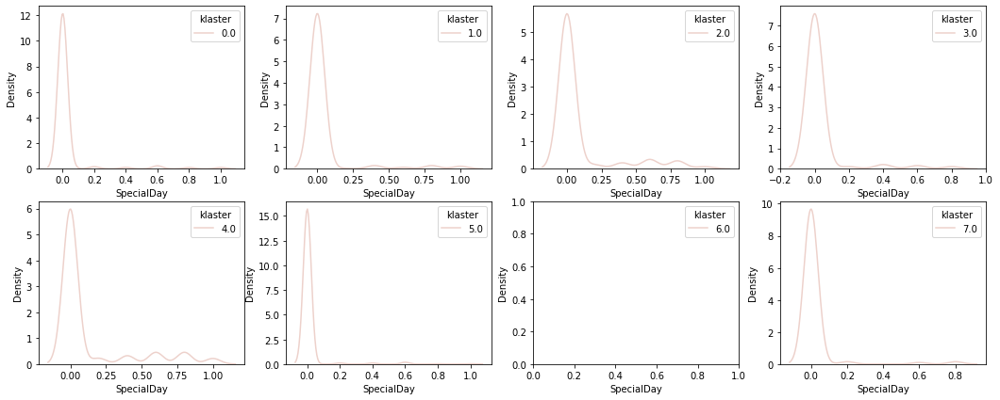

Gęstości dla  Month


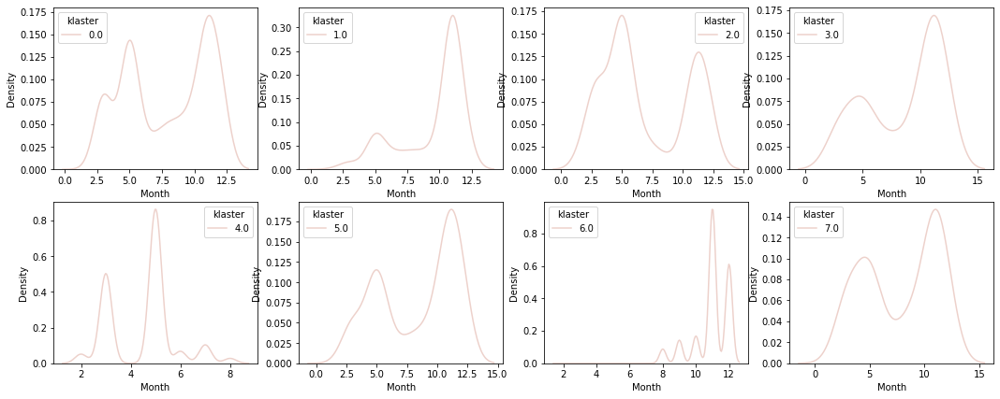

Gęstości dla  OperatingSystems


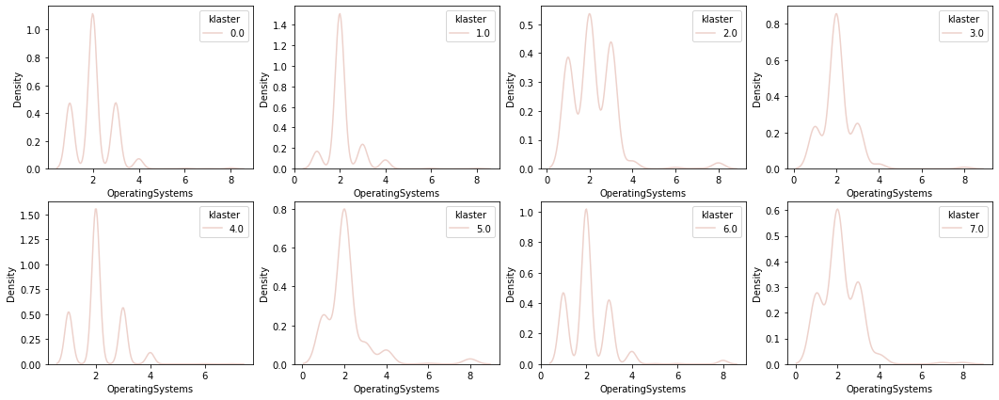

Gęstości dla  Browser


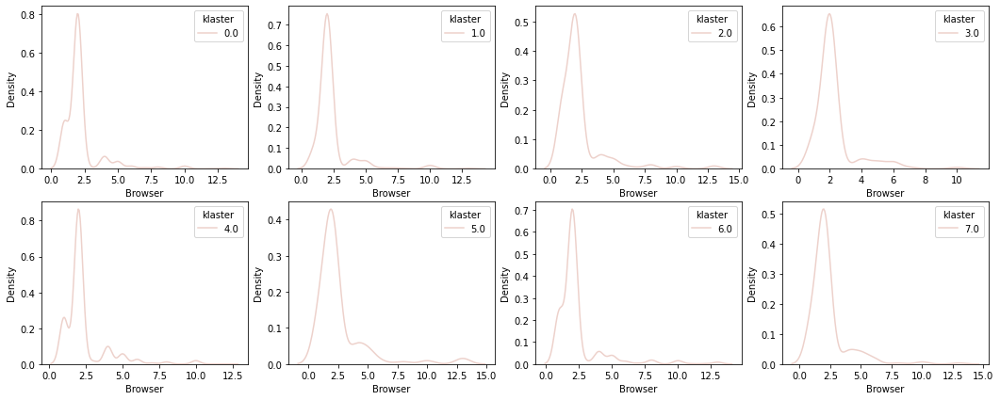

Gęstości dla  Region


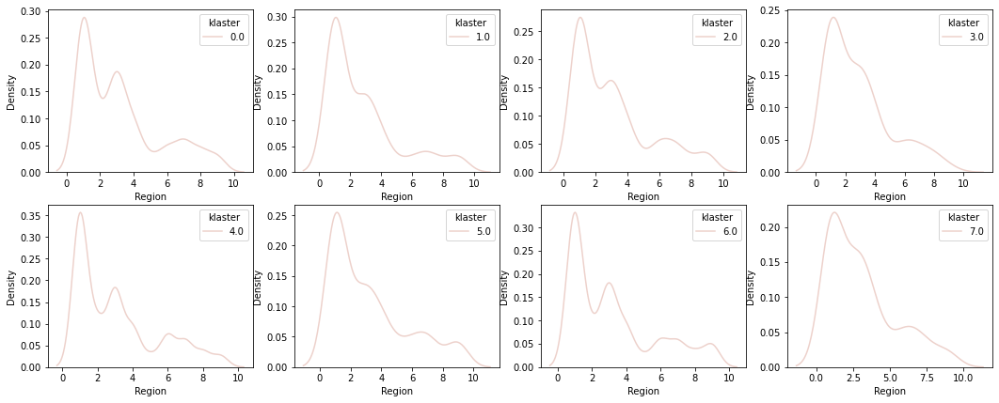

Gęstości dla  TrafficType


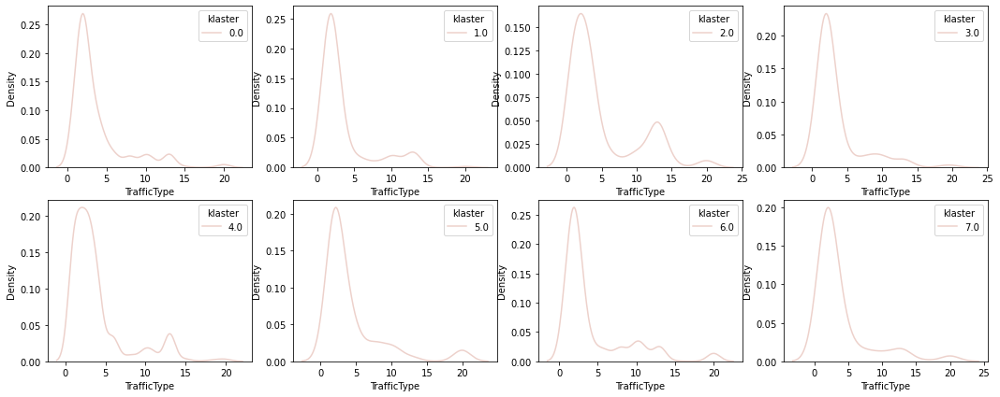

Gęstości dla  VisitorType


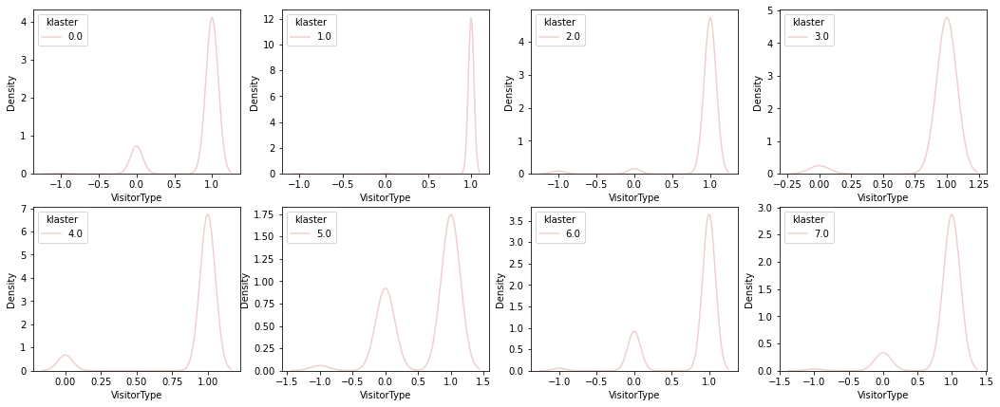

Gęstości dla  Weekend


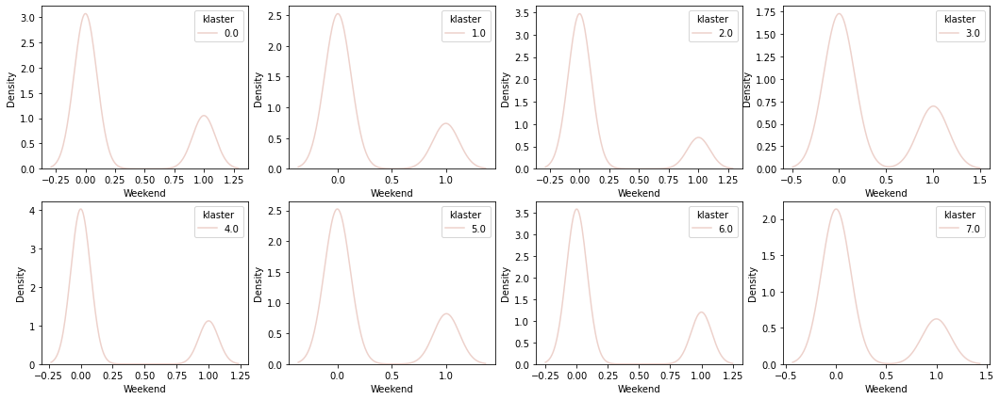

Gęstości dla  Revenue


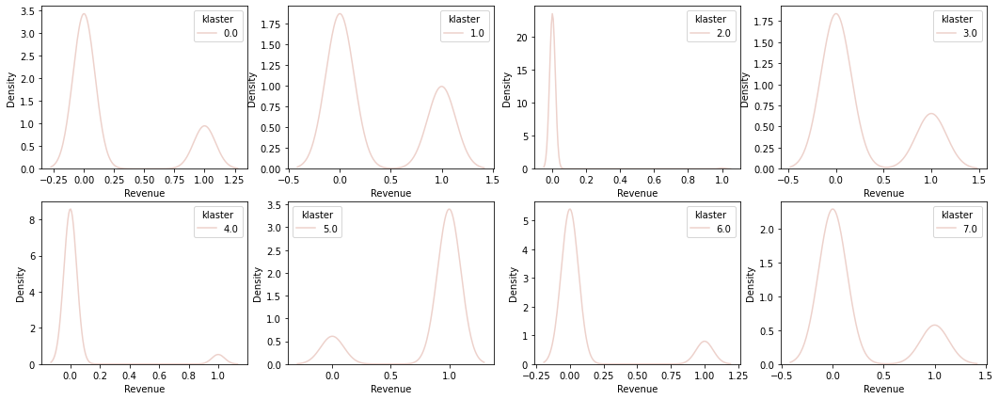

Gęstości dla  klaster


/Users/szymonszmajdzinski/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:305: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/Users/szymonszmajdzinski/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:305: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/Users/szymonszmajdzinski/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:305: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/Users/szymonszmajdzinski/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:305: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/Users/szymonszmajdzinski/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:305: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/Users/szymonszmajdz

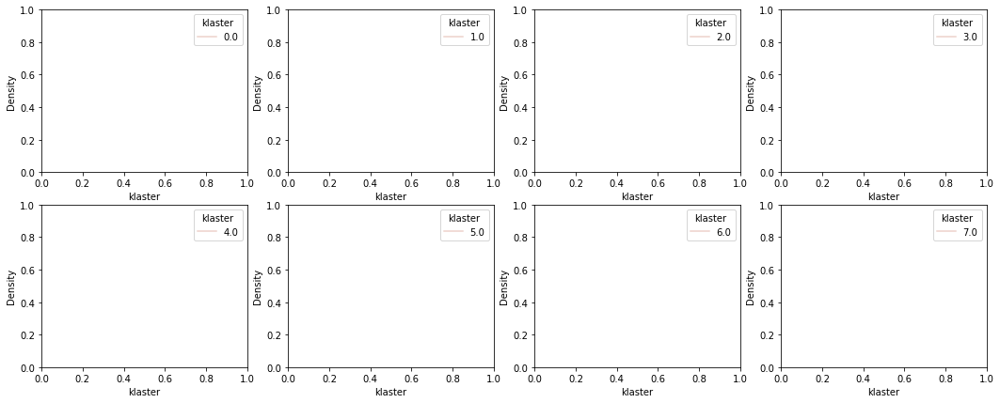

In [67]:
data["klaster"] = fitted
for col in data.columns:
    fig, axs = plt.subplots(nrows=2, ncols=4)
    fig.set_size_inches(18, 7)
    print("Gęstości dla ", col)
    for i in range(8):
        sns.kdeplot(data=data[data.klaster == i], x=data[col], hue = "klaster", ax=axs[i // 4, i%4])

    plt.show()

In [88]:
7%4

3